# Temperature Forecast Project using ML

## Project Description

This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.

https://raw.githubusercontent.com/dsrscientist/Dataset2/main/temperature.csv


Importing the various libraries required

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
df=pd.read_csv("temp.csv")
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [3]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


Checking the Target Variable 'Next_Tmax'

In [4]:
df['Next_Tmax']

0       29.1
1       30.5
2       31.1
3       31.7
4       31.2
        ... 
7747    28.3
7748    28.6
7749    27.8
7750    17.4
7751    38.9
Name: Next_Tmax, Length: 7752, dtype: float64

By looking at the continuous values we can say its a Regression Model

In [5]:
df.tail()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.6450,127.135,212.3350,5.178230,5992.895996,38.9,29.8


In [6]:
df.sample(10)

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
6946,22.0,29-07-2017,30.3,25.6,59.567265,84.332428,30.750951,24.260044,6.338146,74.562040,...,0.000000,0.000000,0.000000,37.5102,127.086,21.9668,0.1332,5455.287598,32.6,24.6
5940,16.0,20-08-2016,32.6,25.6,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,37.4697,126.995,82.2912,2.2579,4754.415039,34.1,25.2
1363,14.0,23-08-2013,28.9,22.4,34.266239,85.201126,32.443110,24.667006,6.162952,15.618481,...,0.000000,0.000000,0.000000,37.4967,126.927,30.9680,0.6180,4713.868652,32.0,22.1
2589,15.0,10-08-2014,26.0,19.3,52.258133,95.178917,27.988572,18.904551,6.719015,36.586483,...,0.000000,0.000000,0.000000,37.5507,126.937,30.0464,0.8552,5165.472656,28.1,17.9
7735,11.0,30-08-2017,23.0,16.5,28.319260,82.678833,27.354836,17.934175,6.031364,44.483636,...,0.000000,0.000000,0.000000,37.5372,127.085,28.7000,0.6233,4466.529297,27.4,16.2
7633,9.0,26-08-2017,28.9,18.8,46.674965,86.570068,25.346394,19.305134,4.929446,77.554286,...,0.000000,0.000000,0.000000,37.4967,126.826,50.9312,0.4125,4627.060547,26.8,18.7
1640,16.0,03-07-2014,23.5,19.5,43.987080,85.445656,30.113299,20.892356,5.824990,102.209189,...,0.000000,0.000000,0.164813,37.4697,126.995,82.2912,2.2579,5842.662598,31.8,20.3
7681,7.0,28-08-2017,25.9,17.9,38.463085,92.847839,22.007164,16.112773,9.823587,182.614047,...,0.000000,0.000000,0.000000,37.5776,126.838,12.3700,0.0985,4519.286621,23.2,17.1
4758,9.0,04-07-2016,24.1,21.1,89.879295,97.407509,25.481722,20.750480,12.073915,27.542450,...,0.884587,1.171891,1.193064,37.4967,126.826,50.9312,0.4125,5844.305176,25.9,20.6
6805,6.0,24-07-2017,28.6,25.8,43.775169,85.068741,34.150976,25.844069,6.277406,56.130682,...,0.000000,0.000000,0.000000,37.5102,127.042,54.6384,0.1457,5580.291504,35.7,25.4


In [7]:
df.shape

(7752, 25)

The dataset has 7752 rows and 25 columns

In [8]:
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

All the columns here are of float64 data type and only date is of object datatype

In [9]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [10]:
df.columns.tolist()

['station',
 'Date',
 'Present_Tmax',
 'Present_Tmin',
 'LDAPS_RHmin',
 'LDAPS_RHmax',
 'LDAPS_Tmax_lapse',
 'LDAPS_Tmin_lapse',
 'LDAPS_WS',
 'LDAPS_LH',
 'LDAPS_CC1',
 'LDAPS_CC2',
 'LDAPS_CC3',
 'LDAPS_CC4',
 'LDAPS_PPT1',
 'LDAPS_PPT2',
 'LDAPS_PPT3',
 'LDAPS_PPT4',
 'lat',
 'lon',
 'DEM',
 'Slope',
 'Solar radiation',
 'Next_Tmax',
 'Next_Tmin']

In [11]:
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

In [12]:
df.isnull()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
7748,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
7749,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
7750,True,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [13]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

we can see that there are minimumm 2 and maximum 75 null values are present in the dataset.

In [14]:
df.isna().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

<AxesSubplot:>

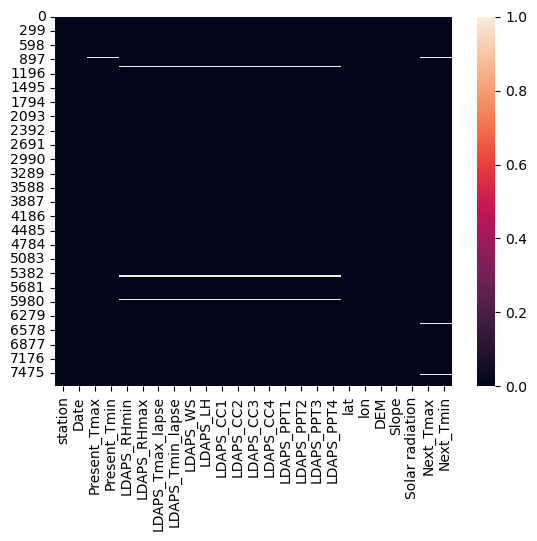

In [15]:
sns.heatmap(df.isnull())

<AxesSubplot:>

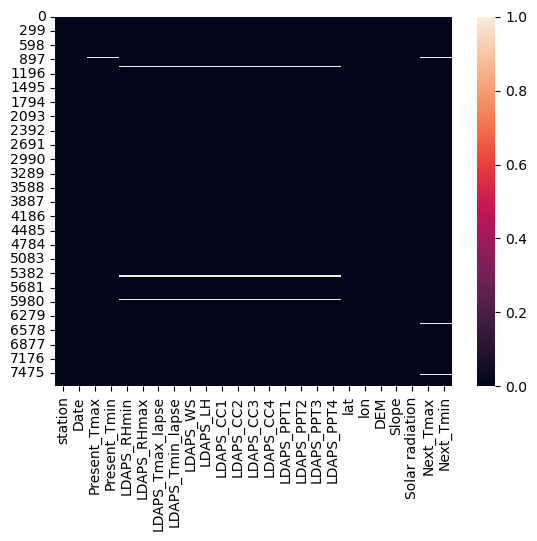

In [16]:
sns.heatmap(df.isna())

We will remove or replace the null values from the dataset using fillna method

In [17]:
df = df.fillna(df.mean())

In [18]:
df.isnull().sum()

station             0
Date                2
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

All the null values are filled now using fillna mean method

But in the date column there are 2 rows which still have nulll values so we will simply drop them

In [19]:
df = df.dropna()

In [20]:
df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

Now the dataste looks clean

In [21]:
df.isna().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

<AxesSubplot:>

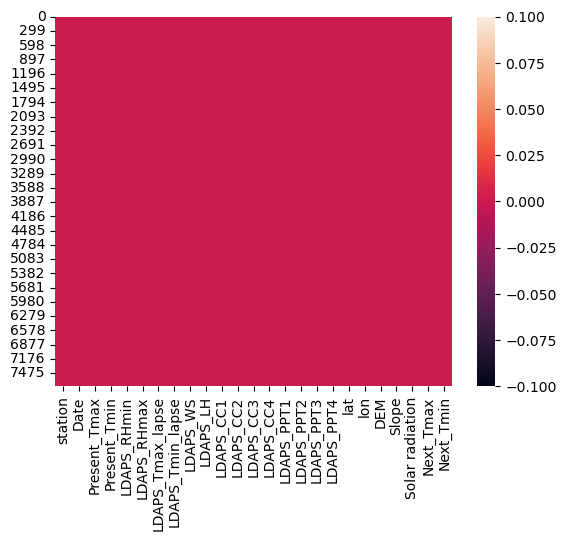

In [22]:
sns.heatmap(df.isna())

In [23]:
df.min()

station                     1.0
Date                 01-07-2013
Present_Tmax               20.0
Present_Tmin               11.3
LDAPS_RHmin           19.794666
LDAPS_RHmax           58.936283
LDAPS_Tmax_lapse      17.624954
LDAPS_Tmin_lapse      14.272646
LDAPS_WS                2.88258
LDAPS_LH             -13.603212
LDAPS_CC1                   0.0
LDAPS_CC2                   0.0
LDAPS_CC3                   0.0
LDAPS_CC4                   0.0
LDAPS_PPT1                  0.0
LDAPS_PPT2                  0.0
LDAPS_PPT3                  0.0
LDAPS_PPT4                  0.0
lat                     37.4562
lon                     126.826
DEM                       12.37
Slope                    0.0985
Solar radiation     4329.520508
Next_Tmax                  17.4
Next_Tmin                  11.3
dtype: object

In [24]:
df.max()

station                    25.0
Date                 31-07-2017
Present_Tmax               37.6
Present_Tmin               29.9
LDAPS_RHmin           98.524734
LDAPS_RHmax          100.000153
LDAPS_Tmax_lapse      38.542255
LDAPS_Tmin_lapse      29.619342
LDAPS_WS              21.857621
LDAPS_LH             213.414006
LDAPS_CC1              0.967277
LDAPS_CC2              0.968353
LDAPS_CC3              0.983789
LDAPS_CC4               0.97471
LDAPS_PPT1            23.701544
LDAPS_PPT2            21.621661
LDAPS_PPT3            15.841235
LDAPS_PPT4            16.655469
lat                      37.645
lon                     127.135
DEM                     212.335
Slope                    5.1782
Solar radiation     5992.895996
Next_Tmax                  38.9
Next_Tmin                  29.8
dtype: object

In [25]:
df.mean()

station               13.000000
Present_Tmax          29.768461
Present_Tmin          23.225736
LDAPS_RHmin           56.758753
LDAPS_RHmax           88.377102
LDAPS_Tmax_lapse      29.613841
LDAPS_Tmin_lapse      23.512993
LDAPS_WS               7.096514
LDAPS_LH              62.495367
LDAPS_CC1              0.368744
LDAPS_CC2              0.356047
LDAPS_CC3              0.318359
LDAPS_CC4              0.299143
LDAPS_PPT1             0.589089
LDAPS_PPT2             0.482338
LDAPS_PPT3             0.276227
LDAPS_PPT4             0.267328
lat                   37.544720
lon                  126.991400
DEM                   61.854944
Slope                  1.256692
Solar radiation     5341.549330
Next_Tmax             30.275435
Next_Tmin             22.932835
dtype: float64

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7750 entries, 0 to 7749
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7750 non-null   float64
 3   Present_Tmin      7750 non-null   float64
 4   LDAPS_RHmin       7750 non-null   float64
 5   LDAPS_RHmax       7750 non-null   float64
 6   LDAPS_Tmax_lapse  7750 non-null   float64
 7   LDAPS_Tmin_lapse  7750 non-null   float64
 8   LDAPS_WS          7750 non-null   float64
 9   LDAPS_LH          7750 non-null   float64
 10  LDAPS_CC1         7750 non-null   float64
 11  LDAPS_CC2         7750 non-null   float64
 12  LDAPS_CC3         7750 non-null   float64
 13  LDAPS_CC4         7750 non-null   float64
 14  LDAPS_PPT1        7750 non-null   float64
 15  LDAPS_PPT2        7750 non-null   float64
 16  LDAPS_PPT3        7750 non-null   float64


In [27]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [28]:
df['station'].nunique()

25

In [29]:
df['Date'].nunique()

310

In [30]:
df['Present_Tmax'].nunique()

168

In [31]:
df['Present_Tmin'].nunique()

156

In [32]:
df['LDAPS_RHmin'].nunique()

7673

In [33]:
df['LDAPS_RHmax'].nunique()

7665

In [34]:
df['LDAPS_Tmax_lapse'].nunique()

7676

In [35]:
df['LDAPS_Tmin_lapse'].nunique()

7676

In [36]:
df['LDAPS_WS'].nunique()

7676

In [37]:
df['LDAPS_LH'].nunique()

7676

In [38]:
df['LDAPS_CC1'].nunique()

7570

In [39]:
df['LDAPS_CC2'].nunique()

7583

In [40]:
df['LDAPS_CC3'].nunique()

7600

In [41]:
df['LDAPS_CC4'].nunique()

7525

In [42]:
df['LDAPS_PPT1'].nunique()

2813

In [43]:
df['LDAPS_PPT2'].nunique()

2511

In [44]:
df['LDAPS_PPT3'].nunique()

2357

In [45]:
df['LDAPS_PPT4'].nunique()

1919

In [46]:
df['lat'].nunique()

12

In [47]:
df['lon'].nunique()

25

In [48]:
df['DEM'].nunique()

25

In [49]:
df['Slope'].nunique()

25

In [50]:
df['Solar radiation'].nunique()

1575

In [51]:
df['Next_Tmax'].nunique()

184

In [52]:
df['Next_Tmin'].nunique()

158

In [53]:
df.nunique().to_frame('No of unique values')

,No of unique values
station,25
Date,310
Present_Tmax,168
Present_Tmin,156
LDAPS_RHmin,7673
LDAPS_RHmax,7665
LDAPS_Tmax_lapse,7676
LDAPS_Tmin_lapse,7676
LDAPS_WS,7676
LDAPS_LH,7676


here we have kept all count of all Unique values of all the columns in a list

In [54]:
df.shape

(7750, 25)

In [55]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,...,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000,7750.000000
mean,13.000000,29.768461,23.225736,56.758753,88.377102,29.613841,23.512993,7.096514,62.495367,0.368744,...,0.482338,0.276227,0.267328,37.544720,126.991400,61.854944,1.256692,5341.549330,30.275435,22.932835
std,7.211568,2.953516,2.398327,14.585101,7.149011,2.928357,2.330881,2.166519,33.516382,0.261096,...,1.737965,1.142722,1.185994,0.050335,0.079406,54.256953,1.369833,428.996445,3.117994,2.478851
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098500,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,46.048225,84.318649,27.693733,22.115268,5.686498,37.547426,0.148339,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.400000
50%,13.000000,29.900000,23.400000,55.313244,89.699505,29.662273,23.735942,6.563068,57.310630,0.320110,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.875000,67.032715,93.703491,31.682567,25.133460,8.005363,83.891182,0.571665,...,0.024224,0.009685,0.000686,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178200,5992.895996,38.900000,29.800000


Key Observations

1. The count of each column says all the columns has equal no of rows
2. The mean values of all columns are slightly higher than the 75% of data indicating presence of skewness in the dataset.
3. The std deviatoin of all the columns looks good except 'LDAPS_RHmin','LDAPS_LH','DEM' and 'Solar radiation' column.
4. The difference between minimum and maximum value is very high in column 'LDAPS_LH' and 'DEM'.

## EXPLORATORY DATA ANALYSIS

#### Univariate Analysis

In [56]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

<AxesSubplot:xlabel='station', ylabel='Count'>

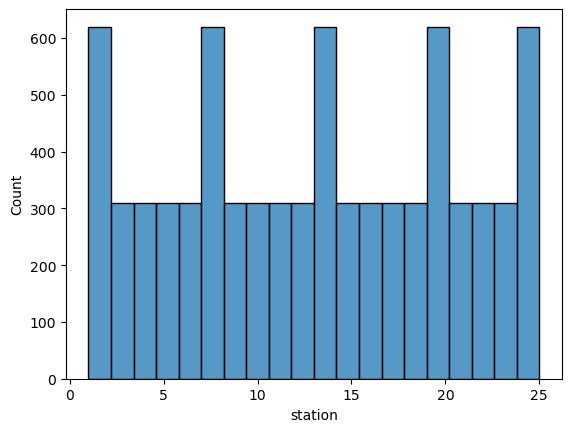

In [58]:
sns.histplot(df['station'])

<AxesSubplot:xlabel='Date', ylabel='Count'>

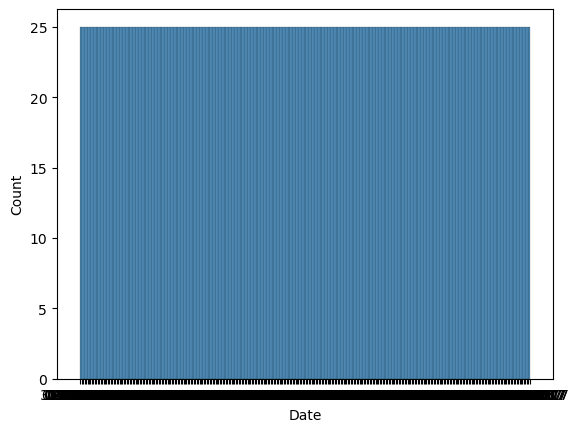

In [58]:
sns.histplot(df['Date'])

<AxesSubplot:xlabel='Present_Tmax', ylabel='Count'>

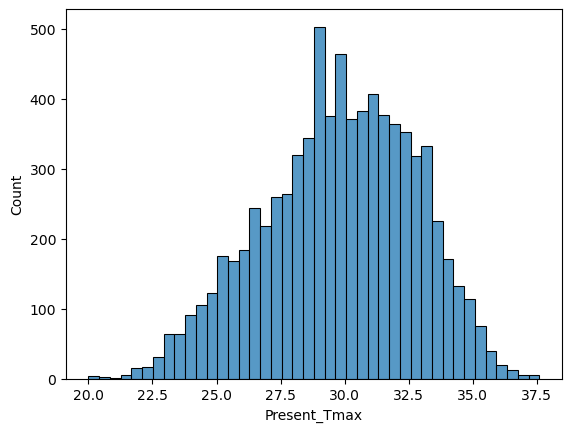

In [59]:
sns.histplot(df['Present_Tmax'])

<AxesSubplot:xlabel='LDAPS_RHmin', ylabel='Count'>

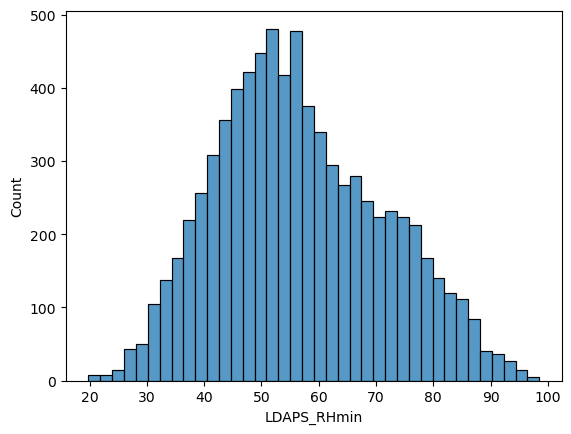

In [60]:
sns.histplot(df['LDAPS_RHmin'])

<AxesSubplot:xlabel='LDAPS_RHmax', ylabel='Count'>

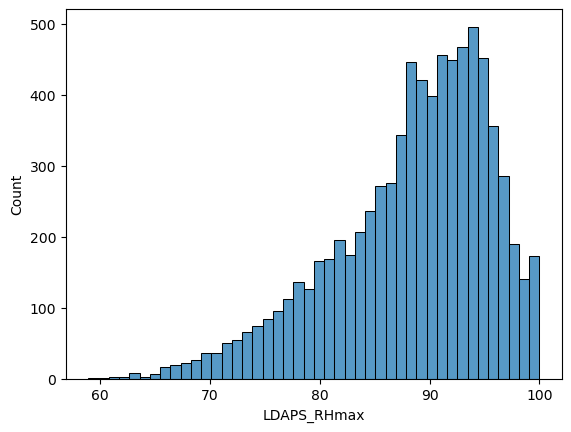

In [61]:
sns.histplot(df['LDAPS_RHmax'])

<AxesSubplot:xlabel='LDAPS_Tmax_lapse', ylabel='Count'>

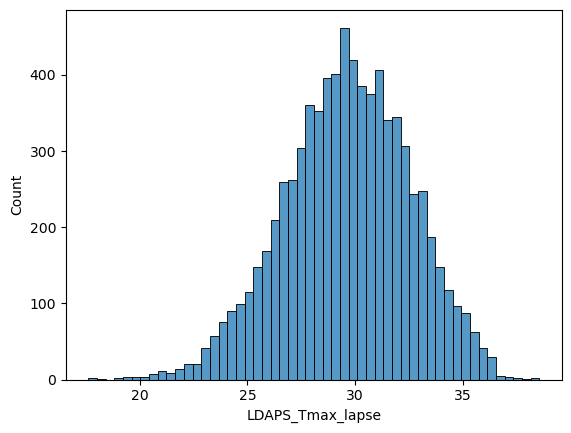

In [62]:
sns.histplot(df['LDAPS_Tmax_lapse'])

<AxesSubplot:xlabel='LDAPS_Tmin_lapse', ylabel='Count'>

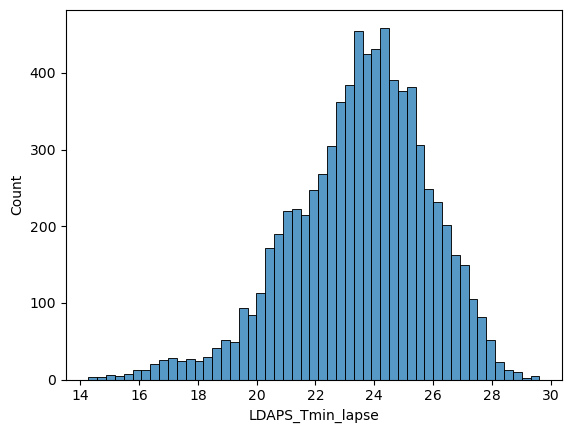

In [63]:
sns.histplot(df['LDAPS_Tmin_lapse'])

In [64]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

<AxesSubplot:xlabel='LDAPS_WS', ylabel='Count'>

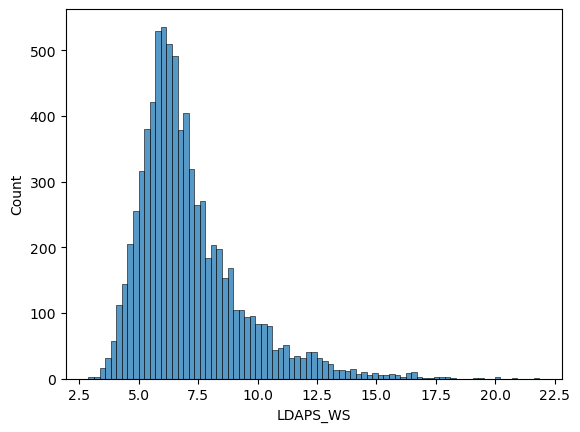

In [64]:
sns.histplot(df['LDAPS_WS'])

<AxesSubplot:xlabel='LDAPS_LH', ylabel='Count'>

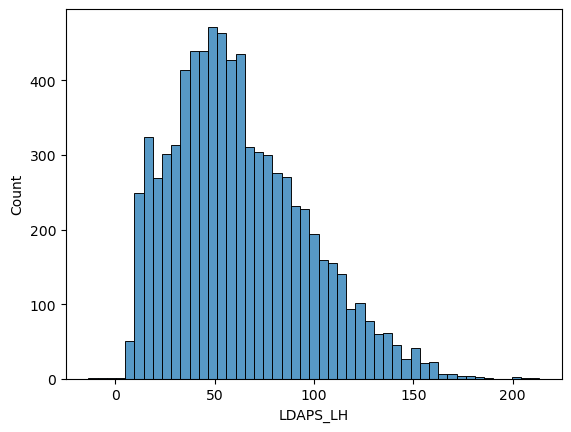

In [65]:
sns.histplot(df['LDAPS_LH'])

<AxesSubplot:xlabel='LDAPS_CC1', ylabel='Count'>

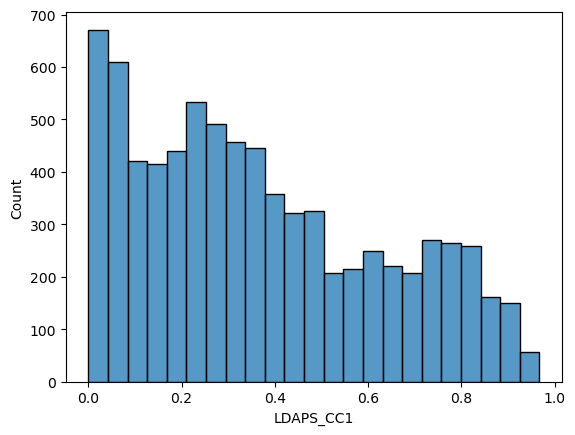

In [66]:
sns.histplot(df['LDAPS_CC1'])

<AxesSubplot:xlabel='LDAPS_CC2', ylabel='Count'>

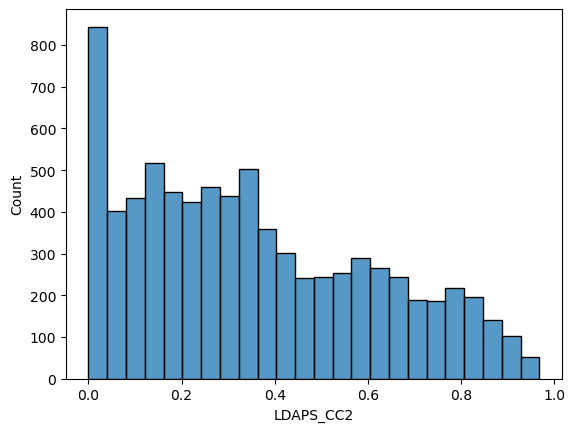

In [67]:
sns.histplot(df['LDAPS_CC2'])

<AxesSubplot:xlabel='LDAPS_CC3', ylabel='Count'>

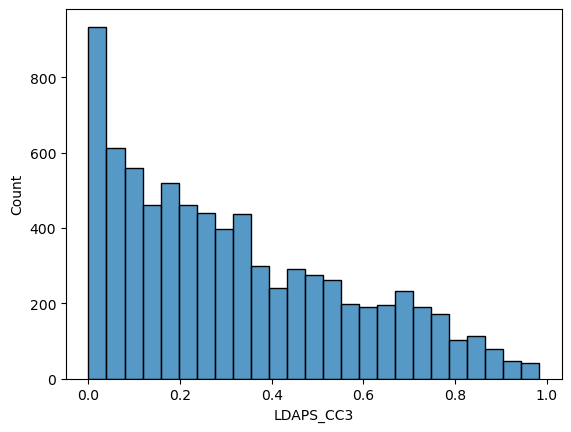

In [69]:
sns.histplot(df['LDAPS_CC3'])

<AxesSubplot:xlabel='LDAPS_CC4', ylabel='Count'>

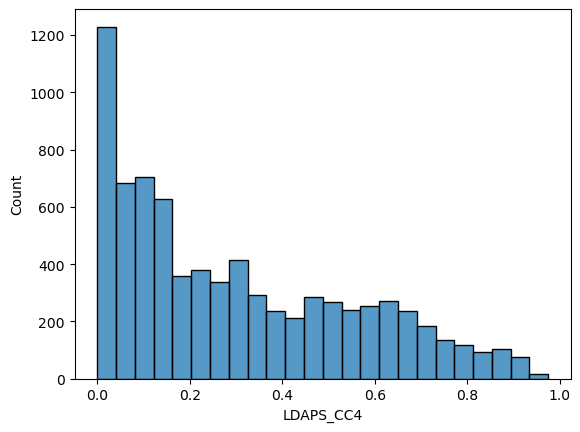

In [70]:
sns.histplot(df['LDAPS_CC4'])

<AxesSubplot:xlabel='LDAPS_PPT1'>

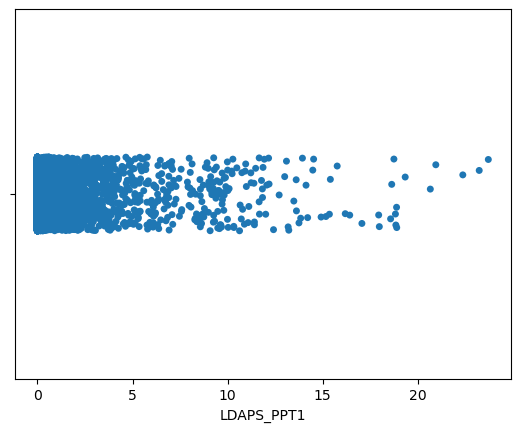

In [70]:
sns.stripplot(df['LDAPS_PPT1'])

<AxesSubplot:xlabel='LDAPS_PPT2'>

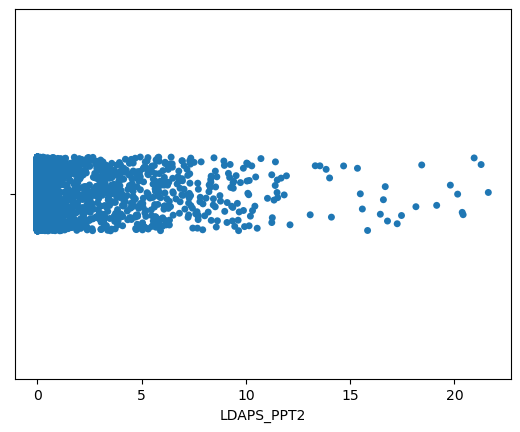

In [71]:
sns.stripplot(df['LDAPS_PPT2'])

<AxesSubplot:xlabel='LDAPS_PPT3'>

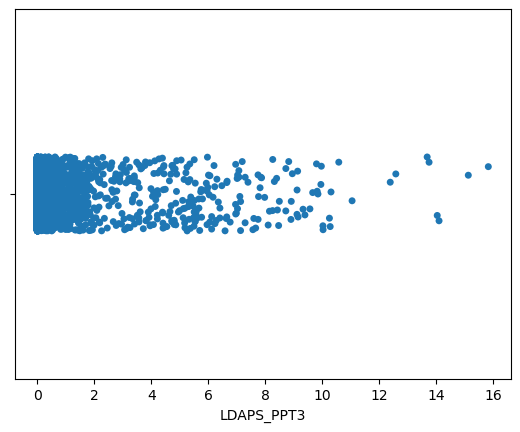

In [73]:
sns.stripplot(df['LDAPS_PPT3'])

<AxesSubplot:xlabel='LDAPS_PPT4'>

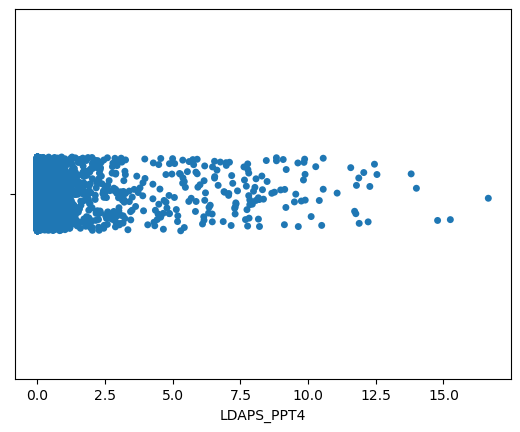

In [72]:
sns.stripplot(df['LDAPS_PPT4'])

<AxesSubplot:xlabel='lat', ylabel='Count'>

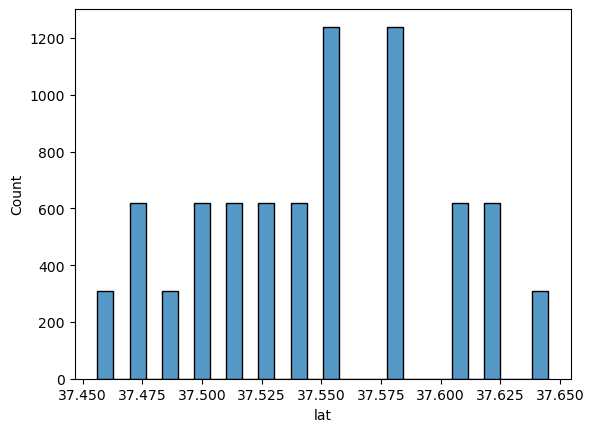

In [75]:
sns.histplot(df['lat'])

<AxesSubplot:xlabel='lon', ylabel='Count'>

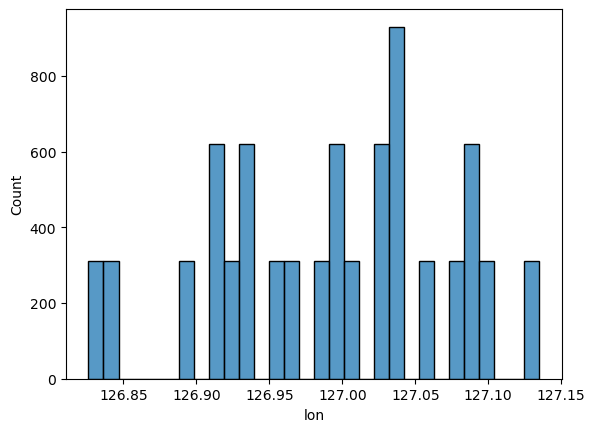

In [73]:
sns.histplot(df['lon'])

<AxesSubplot:xlabel='DEM', ylabel='Count'>

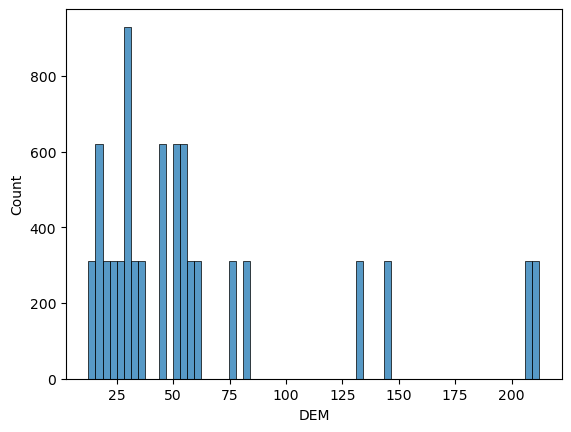

In [74]:
sns.histplot(df['DEM'])

<AxesSubplot:xlabel='Slope', ylabel='Count'>

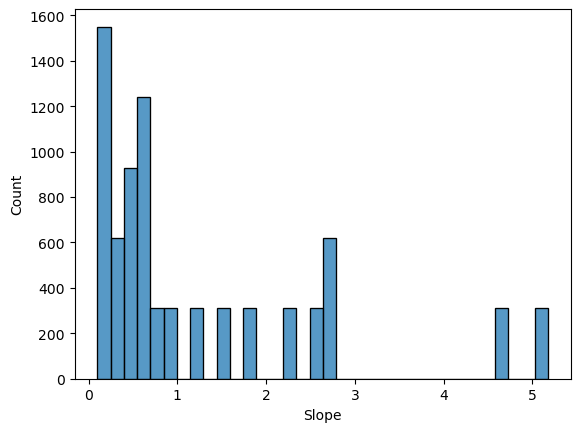

In [75]:
sns.histplot(df['Slope'])

<AxesSubplot:xlabel='Solar radiation', ylabel='Count'>

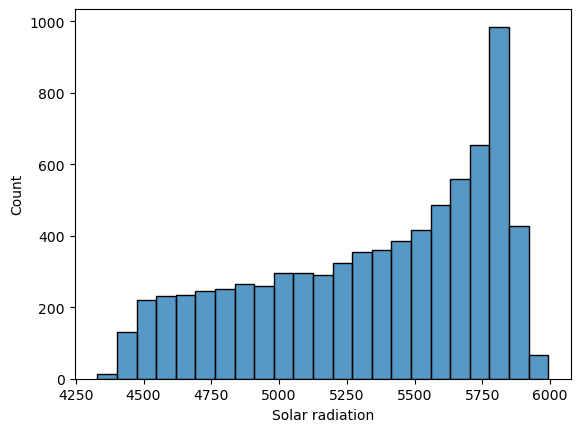

In [76]:
sns.histplot(df['Solar radiation'])

<AxesSubplot:xlabel='Next_Tmax', ylabel='Count'>

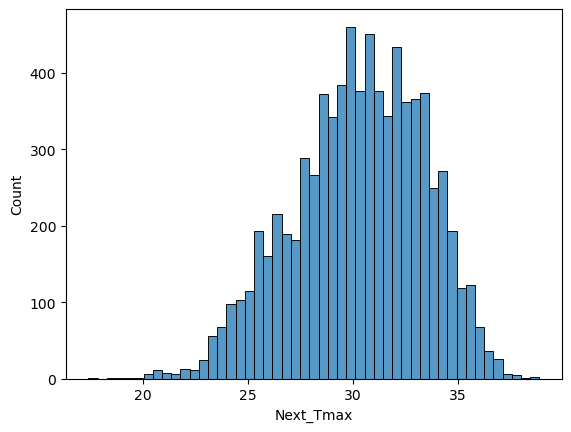

In [77]:
sns.histplot(df['Next_Tmax'])

<AxesSubplot:xlabel='Next_Tmin', ylabel='Count'>

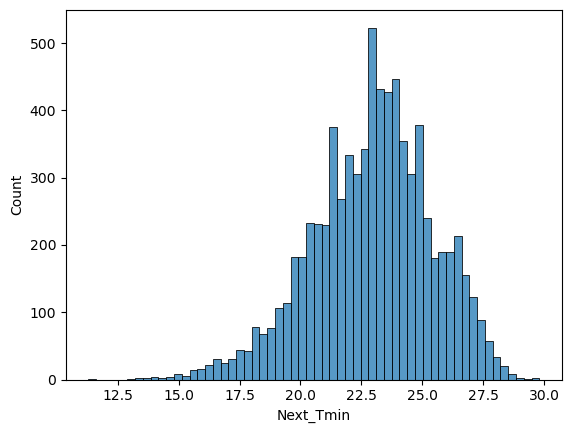

In [78]:
sns.histplot(df['Next_Tmin'])

<AxesSubplot:xlabel='Slope', ylabel='Count'>

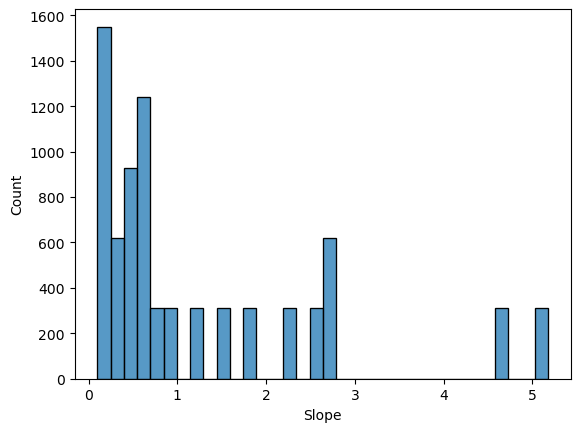

In [79]:
sns.histplot(df['Slope'])

#### Bivariate Analysis

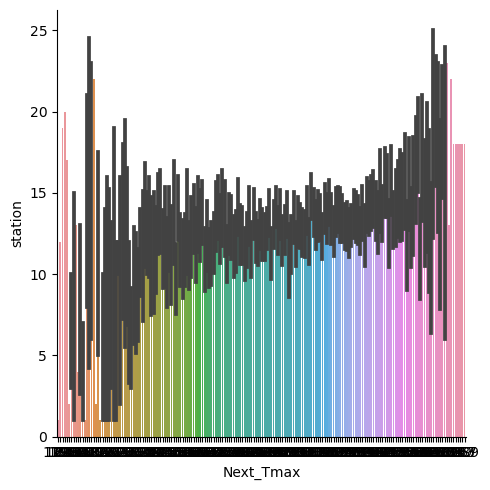

In [81]:
sns.catplot(x='Next_Tmax',y='station',data=df,kind='bar')

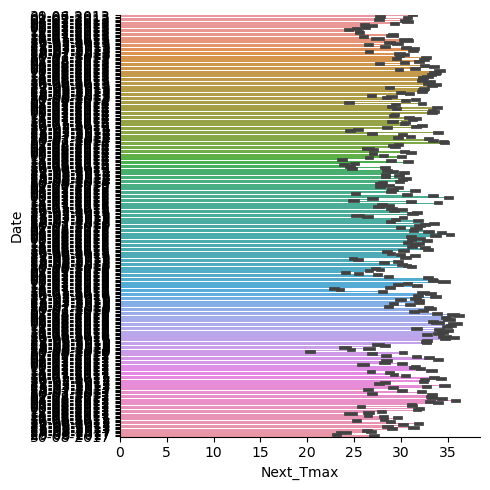

In [84]:
sns.catplot(x='Next_Tmax',y='Date',data=df,kind='bar')

In [85]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

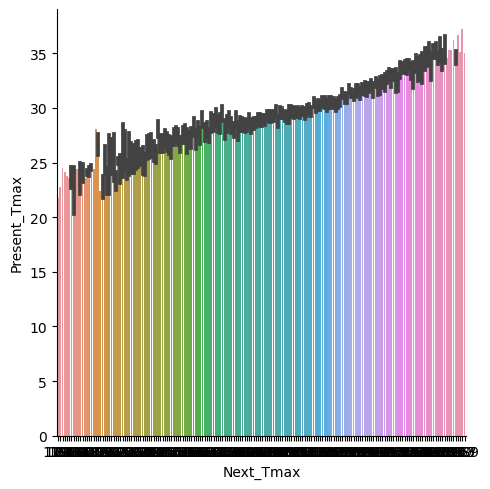

In [86]:
sns.catplot(x='Next_Tmax',y='Present_Tmax',data=df,kind='bar')

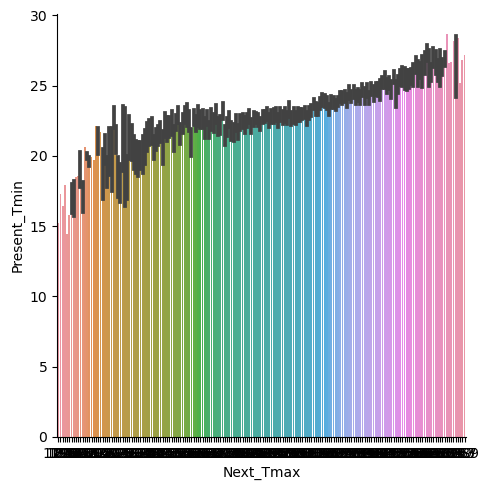

In [87]:
sns.catplot(x='Next_Tmax',y='Present_Tmin',data=df,kind='bar')

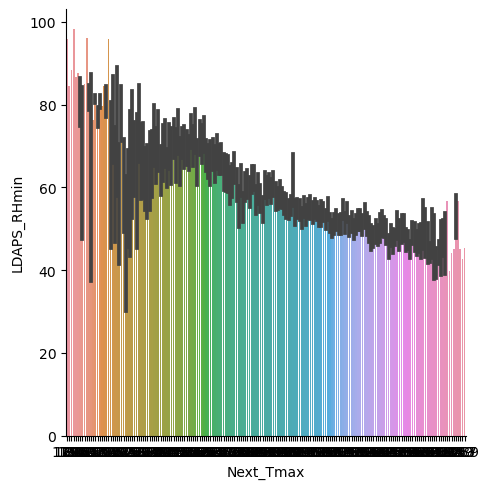

In [88]:
sns.catplot(x='Next_Tmax',y='LDAPS_RHmin',data=df,kind='bar')

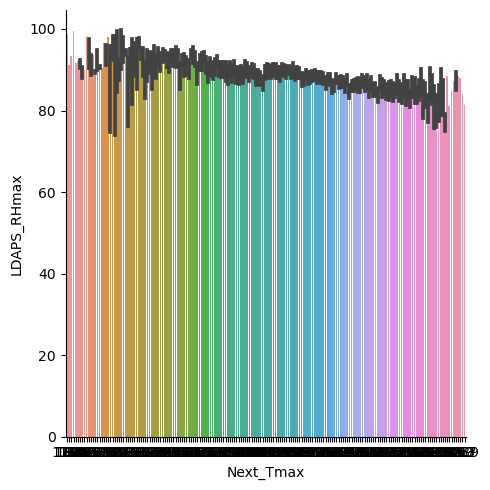

In [89]:
sns.catplot(x='Next_Tmax',y='LDAPS_RHmax',data=df,kind='bar')

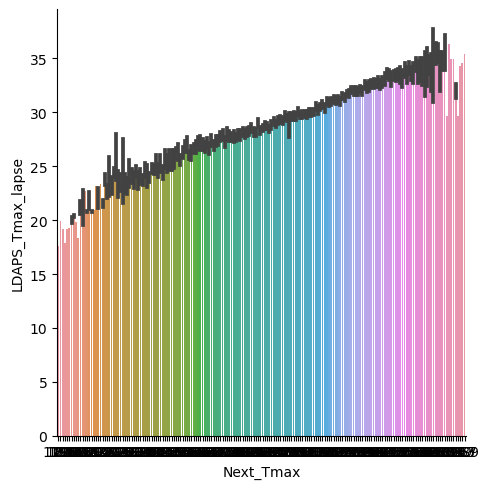

In [90]:
sns.catplot(x='Next_Tmax',y='LDAPS_Tmax_lapse',data=df,kind='bar')

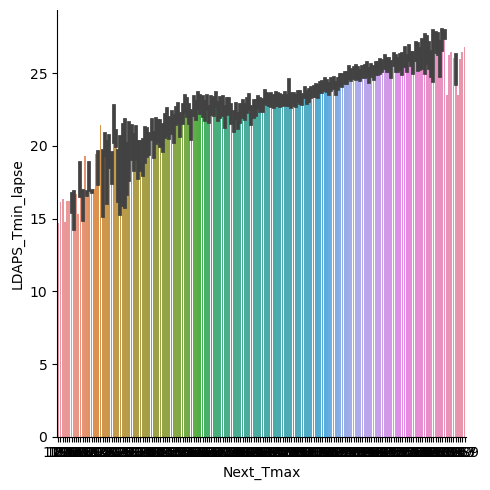

In [91]:
sns.catplot(x='Next_Tmax',y='LDAPS_Tmin_lapse',data=df,kind='bar')

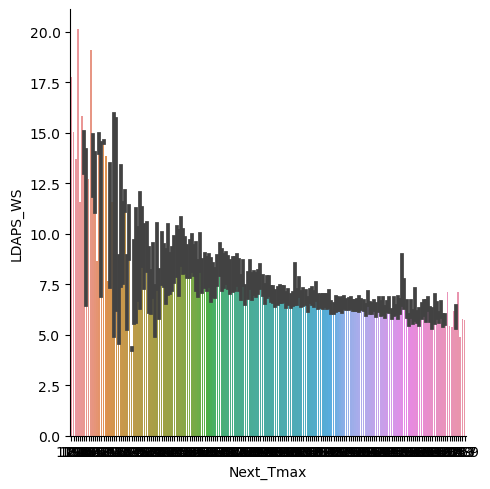

In [92]:
sns.catplot(x='Next_Tmax',y='LDAPS_WS',data=df,kind='bar')

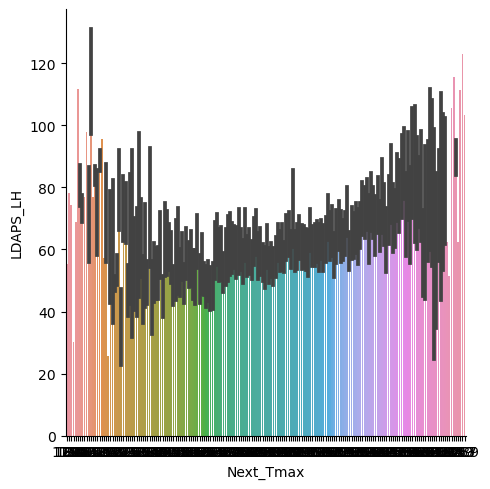

In [93]:
sns.catplot(x='Next_Tmax',y='LDAPS_LH',data=df,kind='bar')

In [94]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

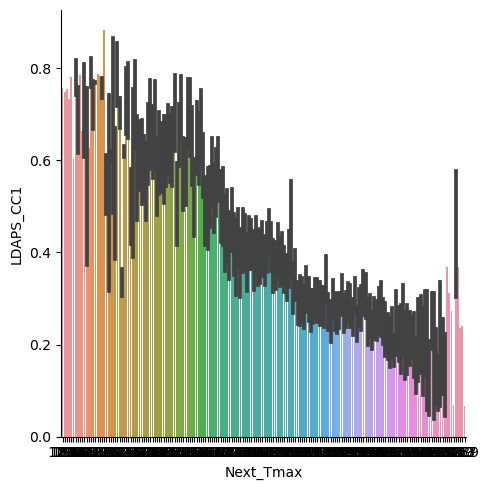

In [95]:
sns.catplot(x='Next_Tmax',y='LDAPS_CC1',data=df,kind='bar')

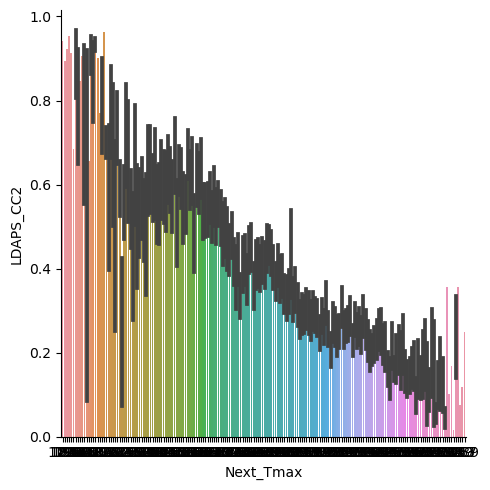

In [96]:
sns.catplot(x='Next_Tmax',y='LDAPS_CC2',data=df,kind='bar')

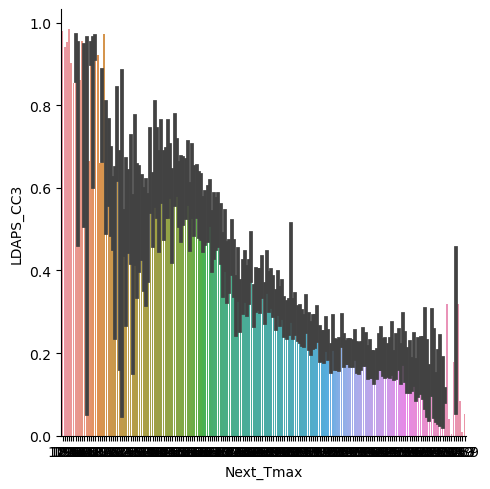

In [97]:
sns.catplot(x='Next_Tmax',y='LDAPS_CC3',data=df,kind='bar')

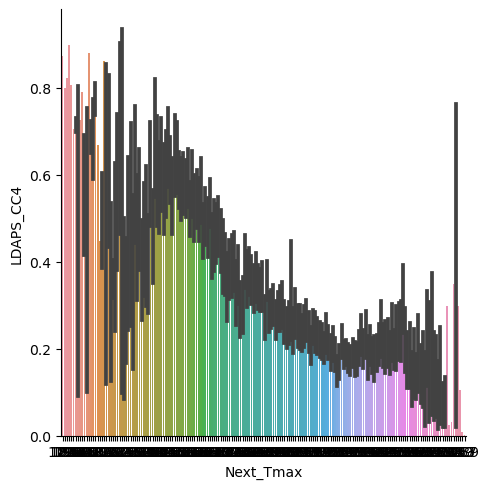

In [98]:
sns.catplot(x='Next_Tmax',y='LDAPS_CC4',data=df,kind='bar')

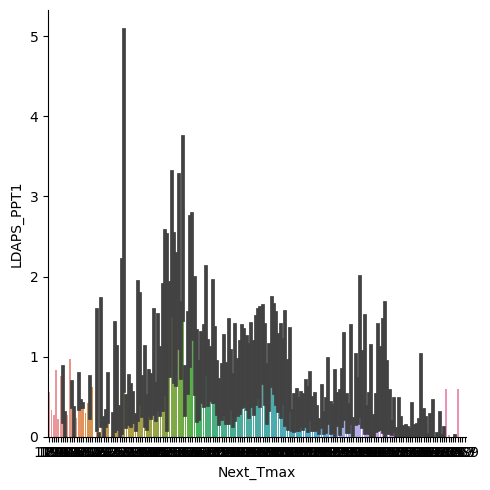

In [99]:
sns.catplot(x='Next_Tmax',y='LDAPS_PPT1',data=df,kind='bar')

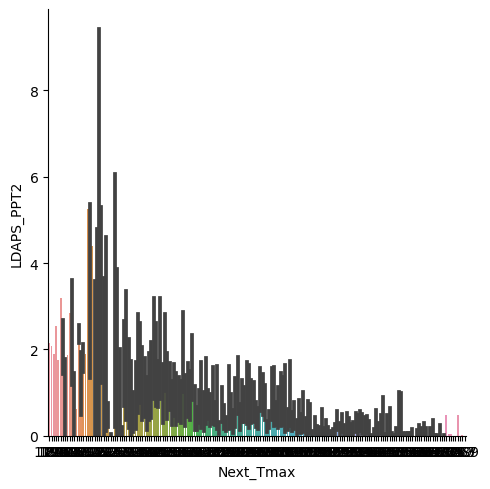

In [100]:
sns.catplot(x='Next_Tmax',y='LDAPS_PPT2',data=df,kind='bar')

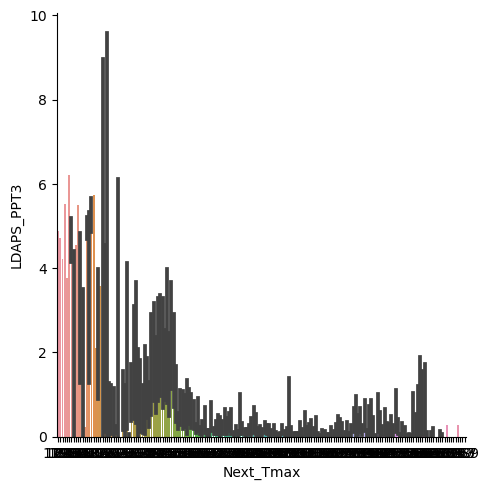

In [101]:
sns.catplot(x='Next_Tmax',y='LDAPS_PPT3',data=df,kind='bar')

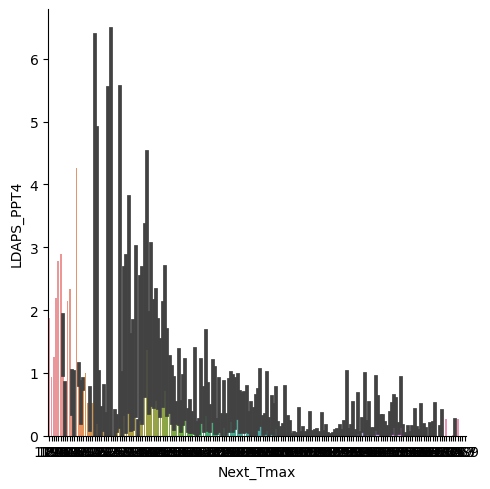

In [102]:
sns.catplot(x='Next_Tmax',y='LDAPS_PPT4',data=df,kind='bar')

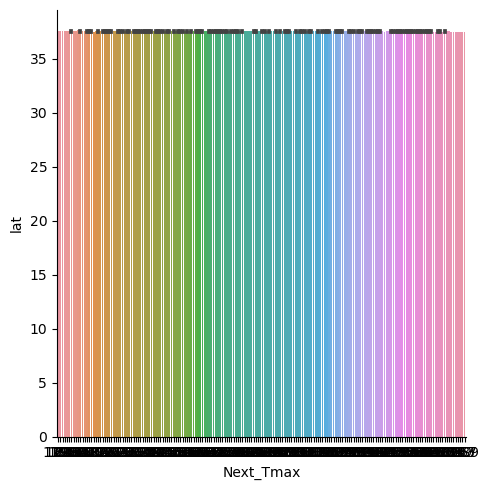

In [103]:
sns.catplot(x='Next_Tmax',y='lat',data=df,kind='bar')

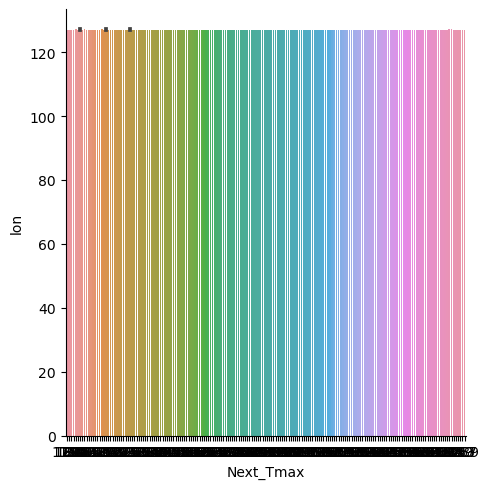

In [104]:
sns.catplot(x='Next_Tmax',y='lon',data=df,kind='bar')

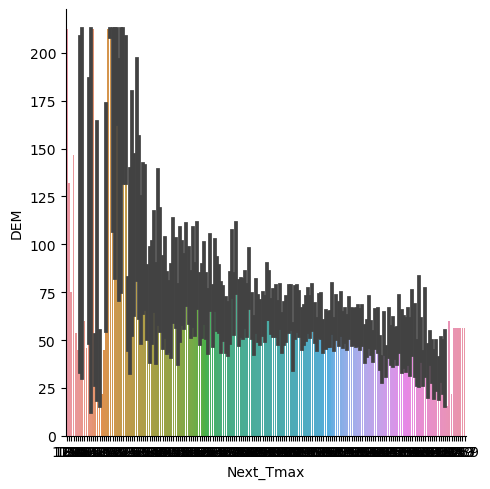

In [105]:
sns.catplot(x='Next_Tmax',y='DEM',data=df,kind='bar')

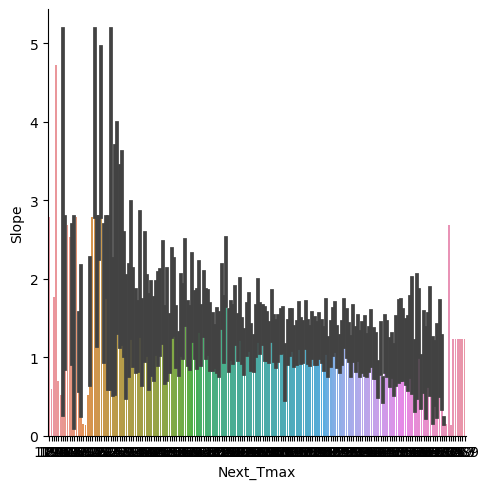

In [106]:
sns.catplot(x='Next_Tmax',y='Slope',data=df,kind='bar')

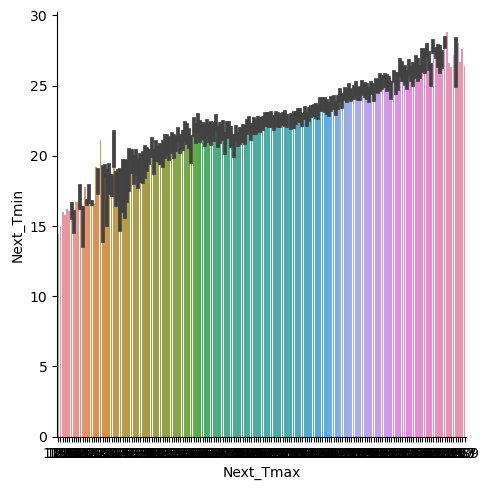

In [107]:
sns.catplot(x='Next_Tmax',y='Next_Tmin',data=df,kind='bar')

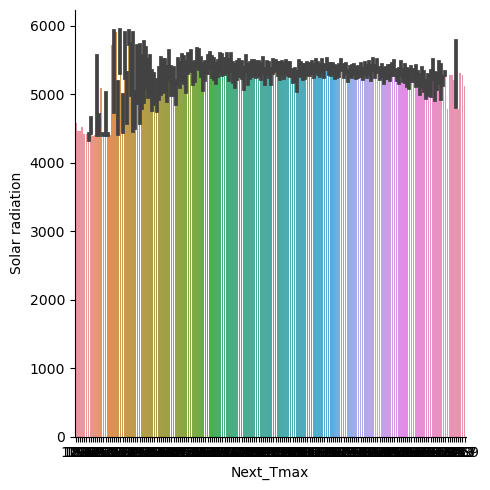

In [108]:
sns.catplot(x='Next_Tmax',y='Solar radiation',data=df,kind='bar')

#### Multivariate Analysis

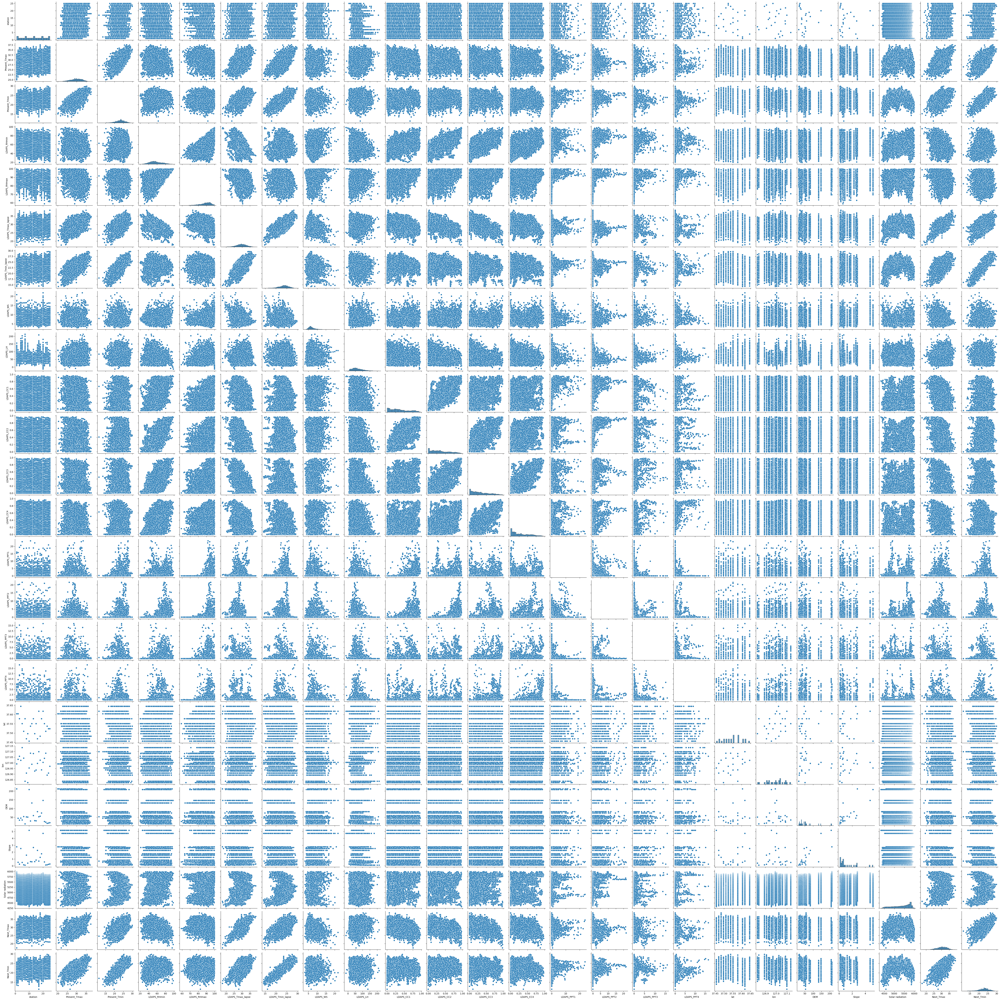

In [109]:
sns.pairplot(df)
plt.show()

In [110]:
corr=df.corr()
corr

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
station,1.000000,0.112786,0.131922,-0.066796,-0.167196,0.069223,0.104911,0.005294,-0.133575,0.006922,...,-0.008328,-0.012609,-0.010529,-0.237610,-0.118763,-0.255970,-0.090113,-0.019011,0.108155,0.128539
Present_Tmax,0.112786,1.000000,0.617699,-0.207063,-0.304833,0.568958,0.622538,-0.125517,0.133333,-0.313699,...,-0.104792,-0.126706,-0.105768,-0.054132,0.007527,-0.188779,-0.107333,-0.027008,0.609320,0.621706
Present_Tmin,0.131922,0.617699,1.000000,0.120862,-0.018417,0.462182,0.762218,-0.038555,-0.012366,0.082934,...,0.064422,-0.051820,-0.068977,-0.080519,-0.045560,-0.252518,-0.148300,0.051659,0.469904,0.795860
LDAPS_RHmin,-0.066796,-0.207063,0.120862,1.000000,0.578472,-0.568528,0.087426,0.292438,-0.073447,0.613375,...,0.390469,0.238624,0.165641,0.085909,-0.077696,0.100944,0.122597,0.243102,-0.441382,0.092732
LDAPS_RHmax,-0.167196,-0.304833,-0.018417,0.578472,1.000000,-0.377319,-0.117110,0.133479,0.237121,0.436177,...,0.228819,0.133394,0.116427,0.194782,0.024226,0.176423,0.218953,0.147954,-0.287324,-0.075301
LDAPS_Tmax_lapse,0.069223,0.568958,0.462182,-0.568528,-0.377319,1.000000,0.652948,-0.317239,0.045198,-0.441029,...,-0.249766,-0.196162,-0.168065,-0.043896,0.089051,-0.180868,-0.164272,0.046232,0.826628,0.585410
LDAPS_Tmin_lapse,0.104911,0.622538,0.762218,0.087426,-0.117110,0.652948,1.000000,-0.133944,-0.137862,0.009424,...,-0.003375,-0.094489,-0.100741,-0.098014,-0.028430,-0.197252,-0.187627,0.158569,0.585726,0.879808
LDAPS_WS,0.005294,-0.125517,-0.038555,0.292438,0.133479,-0.317239,-0.133944,1.000000,0.002215,0.288147,...,0.183573,0.152102,0.134116,0.034599,-0.061801,0.189109,0.169553,0.120288,-0.347854,-0.100688
LDAPS_LH,-0.133575,0.133333,-0.012366,-0.073447,0.237121,0.045198,-0.137862,0.002215,1.000000,-0.149353,...,-0.085559,0.008335,0.012161,0.131827,0.024216,0.053375,0.085062,-0.049060,0.155309,-0.058622
LDAPS_CC1,0.006922,-0.313699,0.082934,0.613375,0.436177,-0.441029,0.009424,0.288147,-0.149353,1.000000,...,0.389690,0.166757,0.088760,-0.009048,-0.007764,-0.015091,-0.021775,0.217643,-0.455045,-0.012729


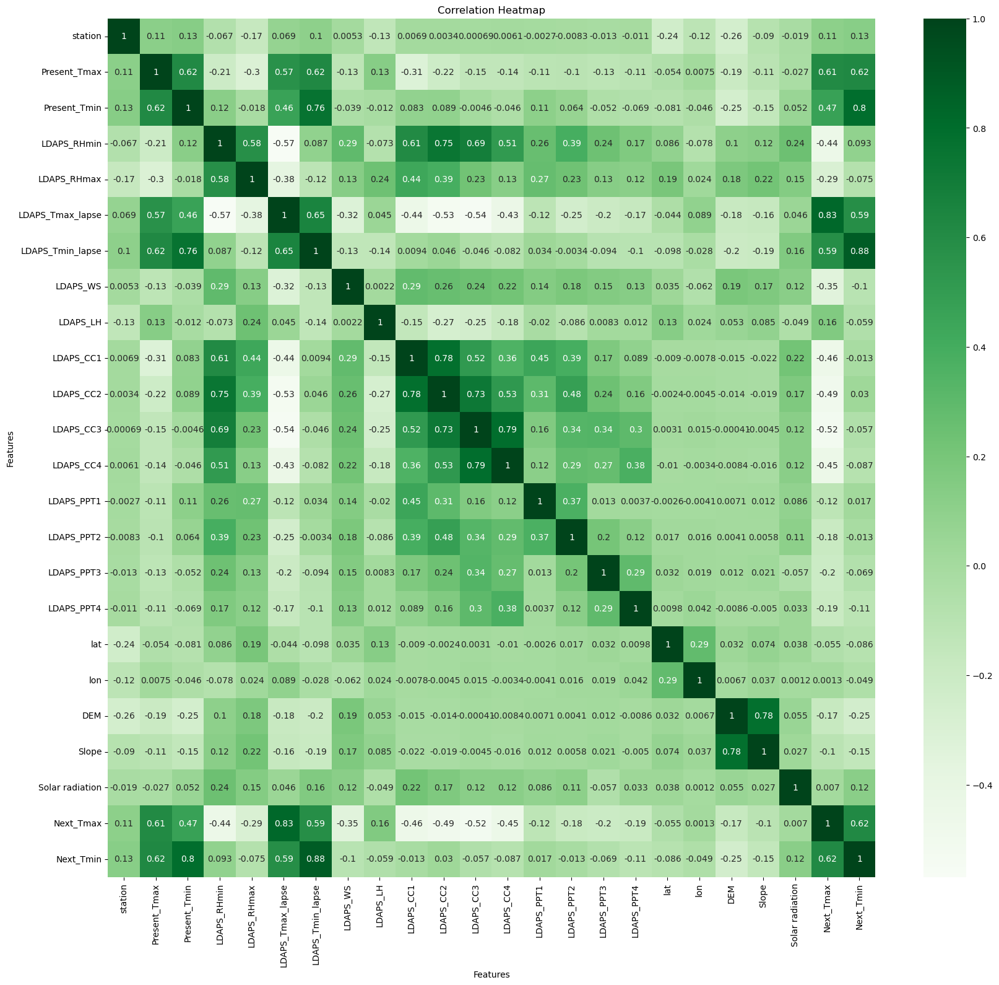

In [111]:
plt.figure(figsize=(20,18))
sns.heatmap(corr,cmap='Greens',annot=True)
plt.title("Correlation Heatmap")
plt.xlabel("Features")
plt.ylabel("Features")
plt.show()

From the above correlation map we observed that:
    
    1. Column Next_Tmin,LDAPS_Tmin_lapse,LDAPS_Tmax_lapse,Present_Tmax,Present_Tmin columns are vary highly positively correlating with target varibale Next_Tmax.
    
    2. Column LDAPS_RHmin,LDAPS_RHmax,LDAPS_WS,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4 are negetively correlating with target variable Next_Tmin
    
    3. Rest of the columns are negetive to modelately correlating with target variable

### Plotting Outliers

<Figure size 3000x2500 with 0 Axes>

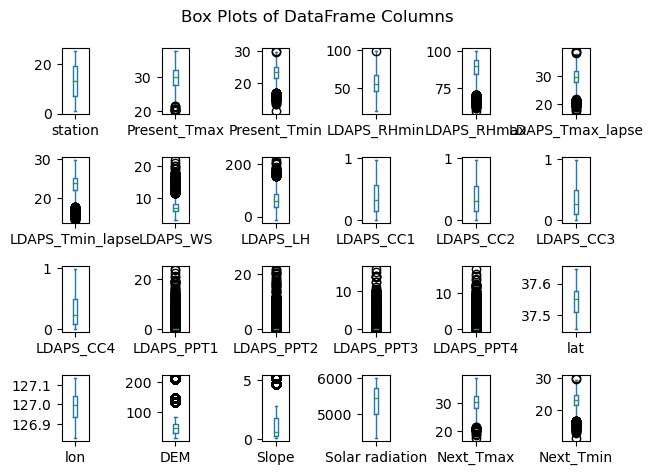

In [112]:
plt.figure(figsize=(30,25))
df.plot(kind='box',subplots=True,layout=(4,6))
plt.suptitle("Box Plots of DataFrame Columns")
plt.tight_layout()
plt.show()

In [113]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

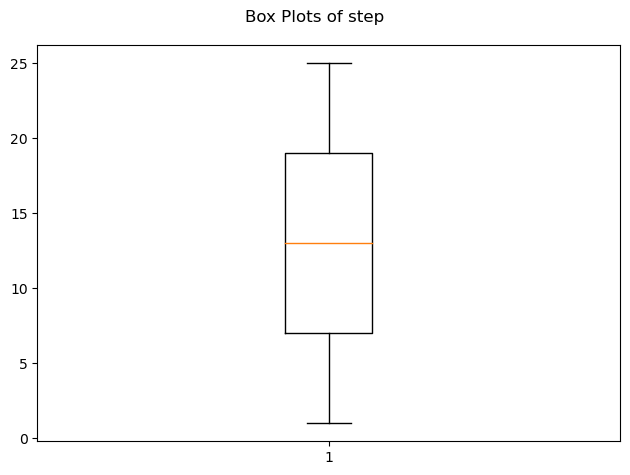

In [114]:
plt.boxplot(df['station'])
plt.suptitle("Box Plots of step")
plt.tight_layout()
plt.show()

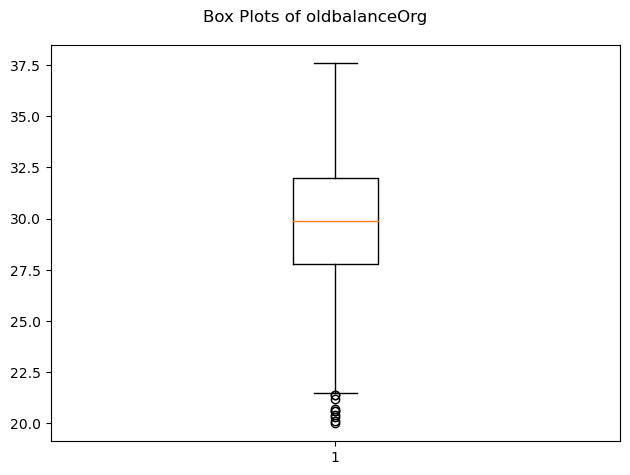

In [115]:
plt.boxplot(df['Present_Tmax'])
plt.suptitle("Box Plots of oldbalanceOrg")
plt.tight_layout()
plt.show()

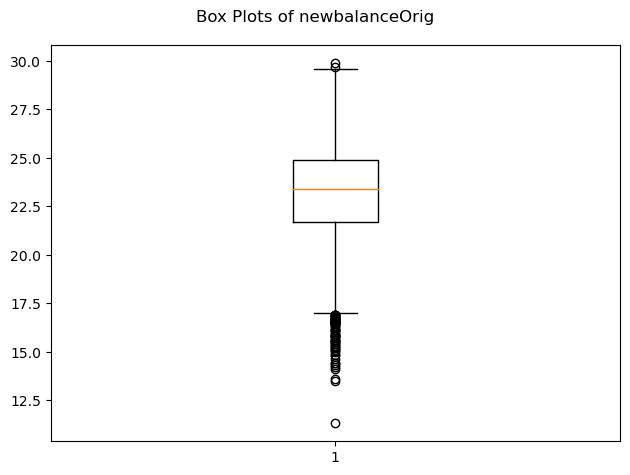

In [116]:
plt.boxplot(df['Present_Tmin'])
plt.suptitle("Box Plots of newbalanceOrig")
plt.tight_layout()
plt.show()

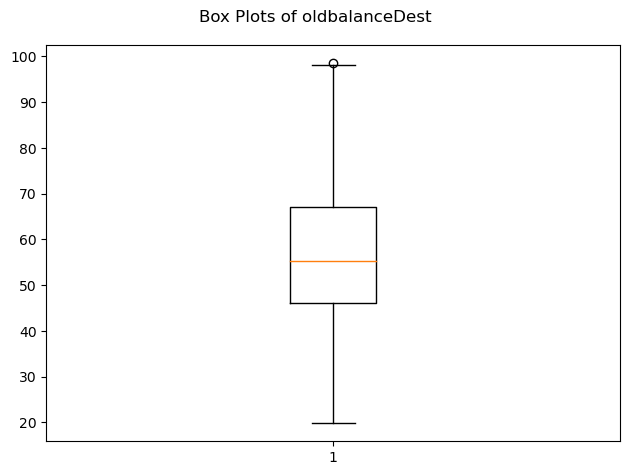

In [117]:
plt.boxplot(df['LDAPS_RHmin'])
plt.suptitle("Box Plots of oldbalanceDest")
plt.tight_layout()
plt.show()

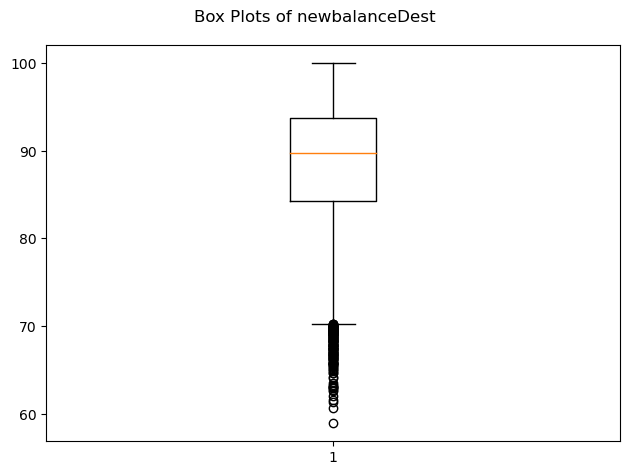

In [118]:
plt.boxplot(df['LDAPS_RHmax'])
plt.suptitle("Box Plots of newbalanceDest")
plt.tight_layout()
plt.show()

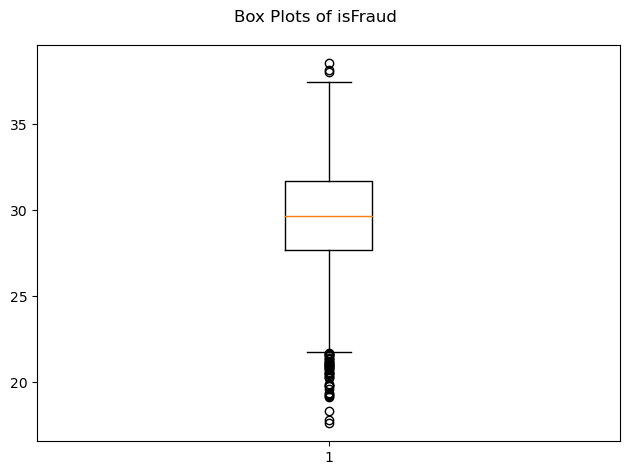

In [119]:
plt.boxplot(df['LDAPS_Tmax_lapse'])
plt.suptitle("Box Plots of isFraud")
plt.tight_layout()
plt.show()

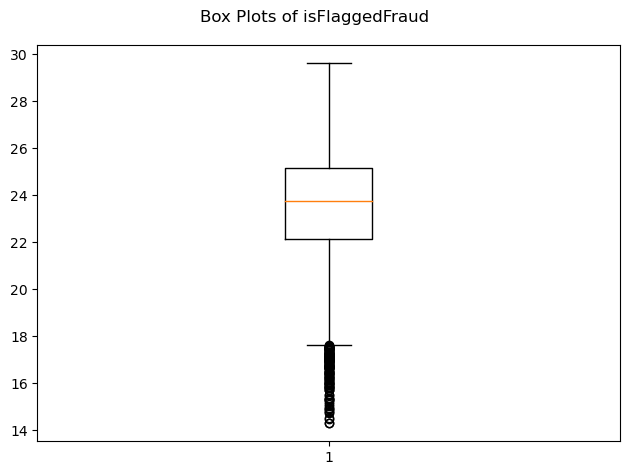

In [120]:
plt.boxplot(df['LDAPS_Tmin_lapse'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

In [121]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

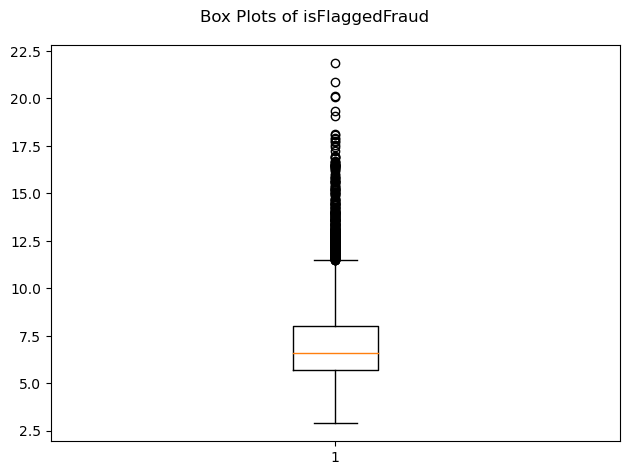

In [122]:
plt.boxplot(df['LDAPS_WS'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

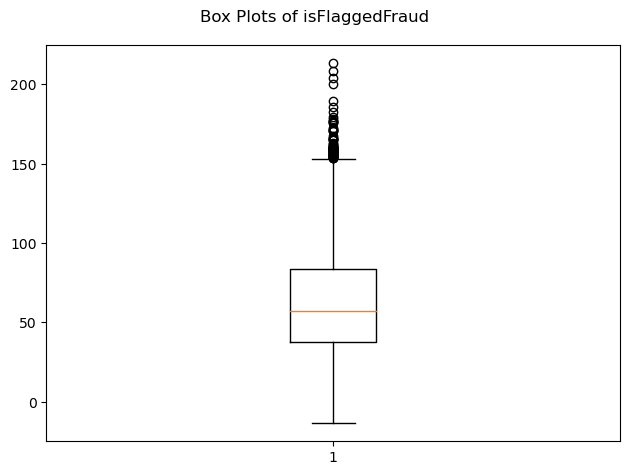

In [123]:
plt.boxplot(df['LDAPS_LH'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

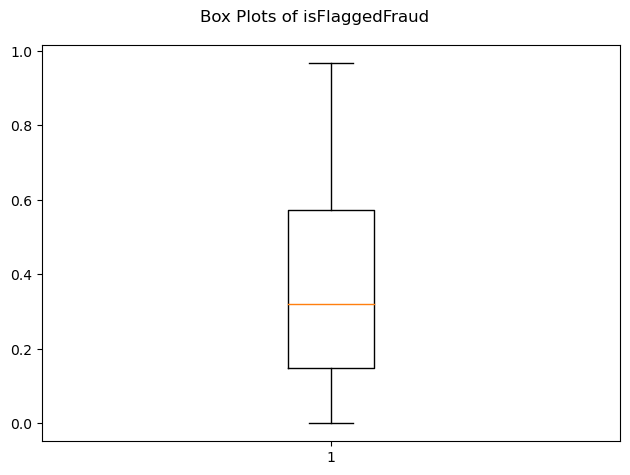

In [124]:
plt.boxplot(df['LDAPS_CC1'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

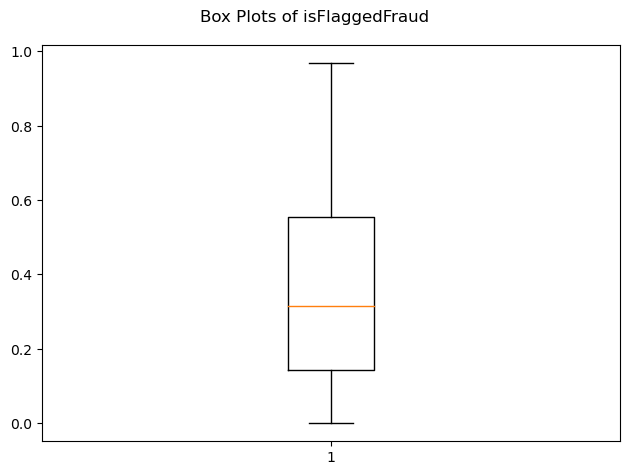

In [125]:
plt.boxplot(df['LDAPS_CC2'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

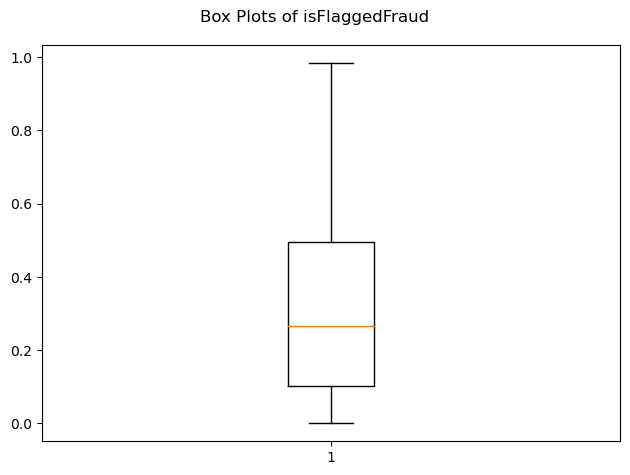

In [126]:
plt.boxplot(df['LDAPS_CC3'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

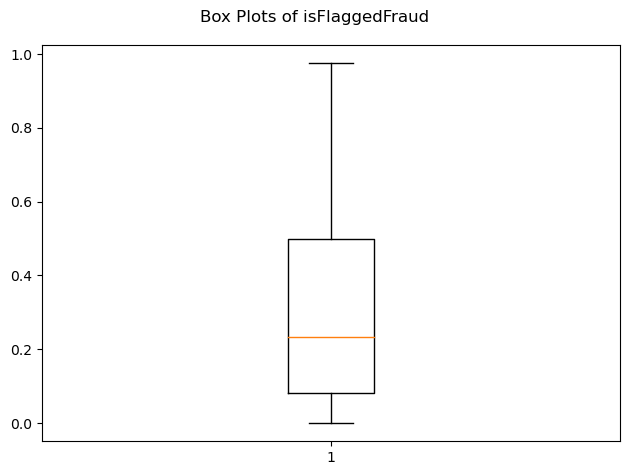

In [127]:
plt.boxplot(df['LDAPS_CC4'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

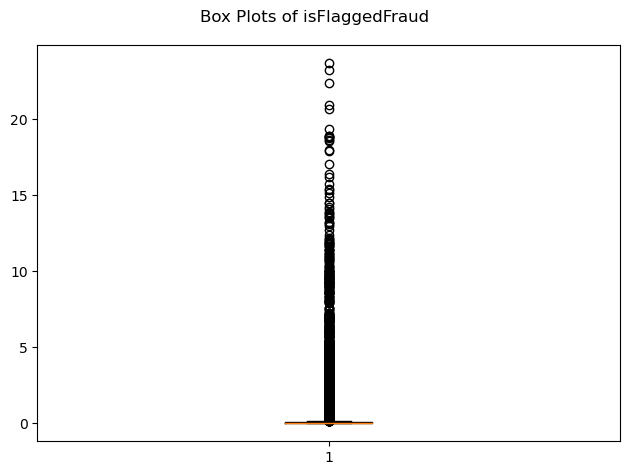

In [128]:
plt.boxplot(df['LDAPS_PPT1'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

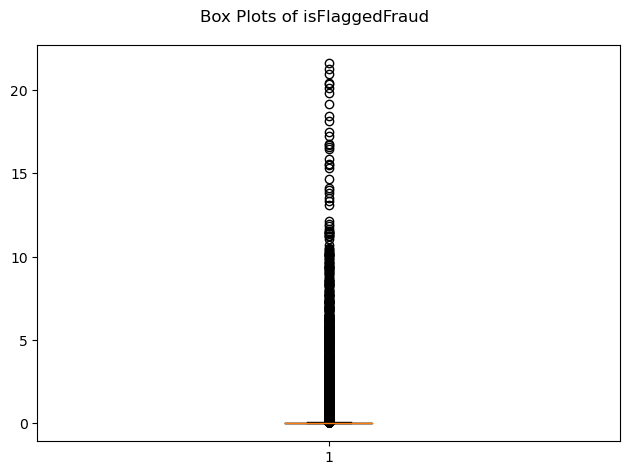

In [129]:
plt.boxplot(df['LDAPS_PPT2'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

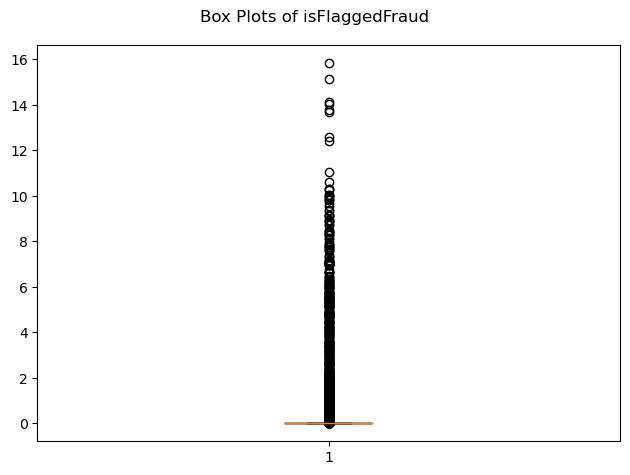

In [130]:
plt.boxplot(df['LDAPS_PPT3'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

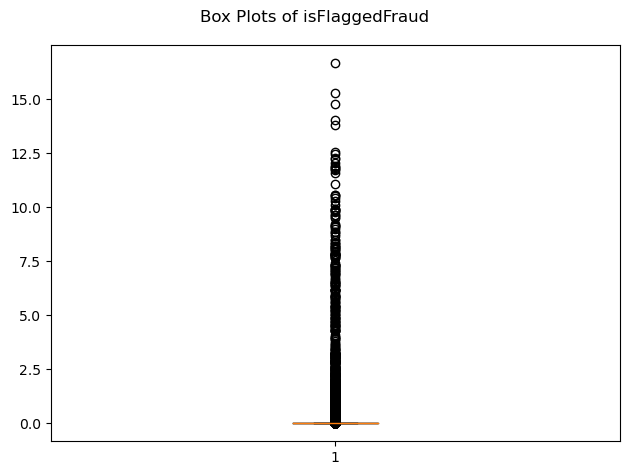

In [131]:
plt.boxplot(df['LDAPS_PPT4'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

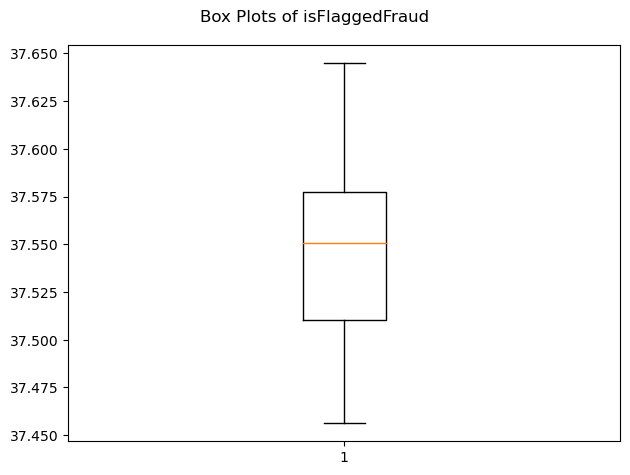

In [132]:
plt.boxplot(df['lat'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

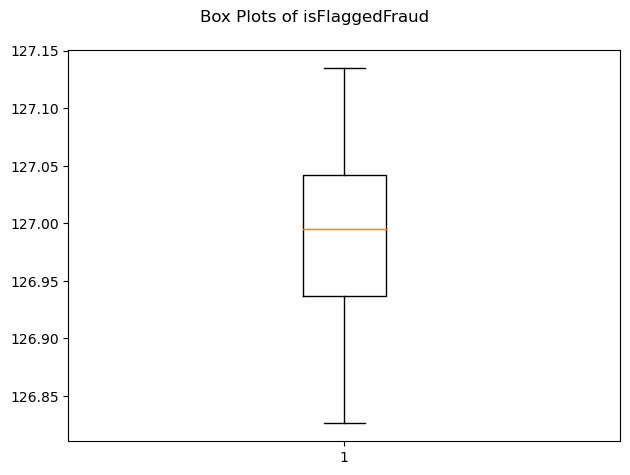

In [133]:
plt.boxplot(df['lon'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

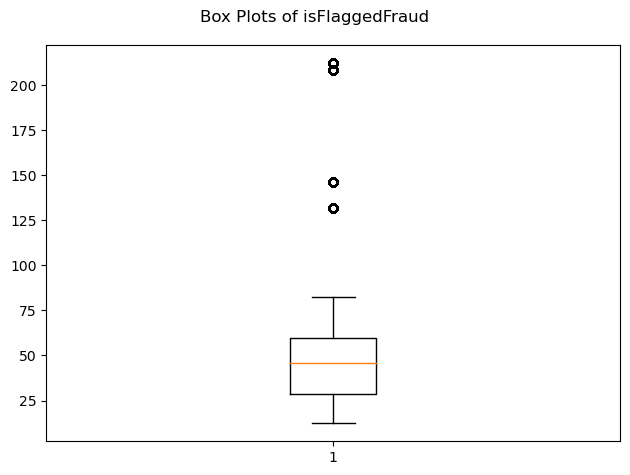

In [134]:
plt.boxplot(df['DEM'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

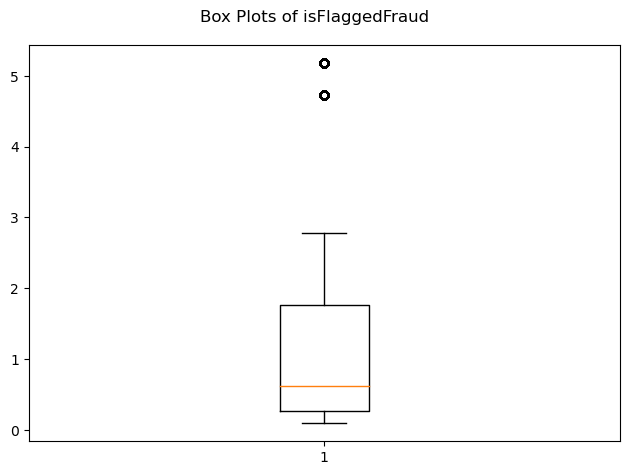

In [135]:
plt.boxplot(df['Slope'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

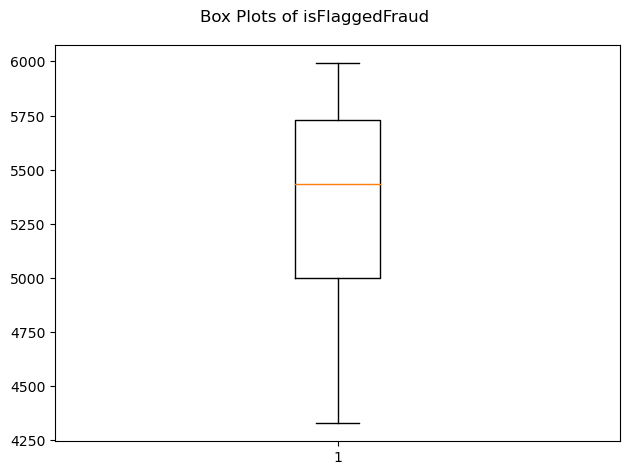

In [136]:
plt.boxplot(df['Solar radiation'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

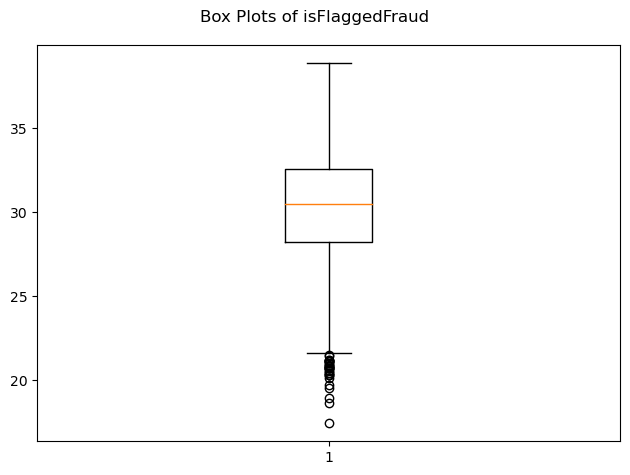

In [137]:
plt.boxplot(df['Next_Tmax'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

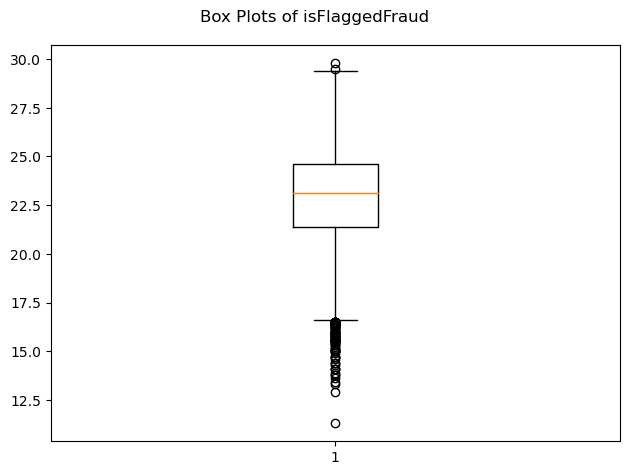

In [138]:
plt.boxplot(df['Next_Tmin'])
plt.suptitle("Box Plots of isFlaggedFraud")
plt.tight_layout()
plt.show()

We observed columns 'Present_Tmax','Present_Tmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4','DEM','Slope','Next_Tmax','Next_Tmin' have outliers present in them

### Checking Skewness

In [59]:
df.skew()

station             0.000000
Present_Tmax       -0.263013
Present_Tmin       -0.357565
LDAPS_RHmin         0.300229
LDAPS_RHmax        -0.850657
LDAPS_Tmax_lapse   -0.224207
LDAPS_Tmin_lapse   -0.579033
LDAPS_WS            1.556422
LDAPS_LH            0.667582
LDAPS_CC1           0.459193
LDAPS_CC2           0.471965
LDAPS_CC3           0.640088
LDAPS_CC4           0.665829
LDAPS_PPT1          5.324404
LDAPS_PPT2          5.713247
LDAPS_PPT3          6.368693
LDAPS_PPT4          6.743231
lat                 0.086942
lon                -0.285300
DEM                 1.723944
Slope               1.563346
Solar radiation    -0.511006
Next_Tmax          -0.335956
Next_Tmin          -0.396873
dtype: float64

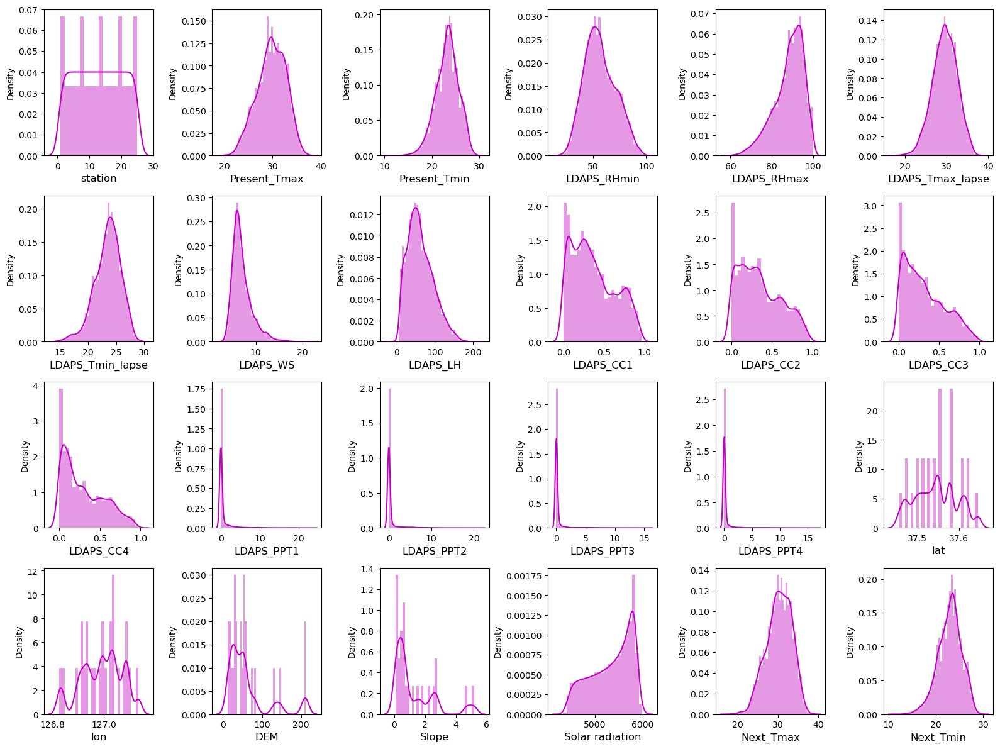

In [60]:
plt.figure(figsize=(16,12))
plotnumber=1
for i in numeric_columns.columns:
    if plotnumber<=24:
        ax=plt.subplot(4,6,plotnumber)
        sns.distplot(numeric_columns[i],color='m')
        plt.xlabel(i,fontsize=12)
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()
plt.show()

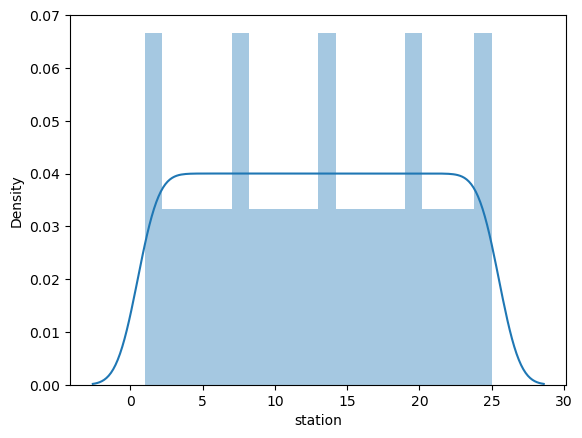

In [60]:
sns.distplot(df['station'])
plt.show()

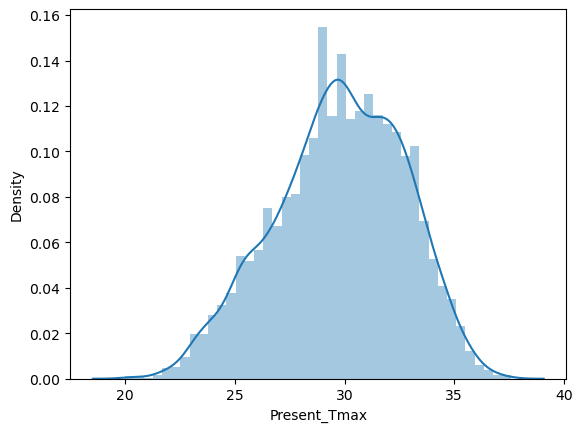

In [61]:
sns.distplot(df['Present_Tmax'])
plt.show()

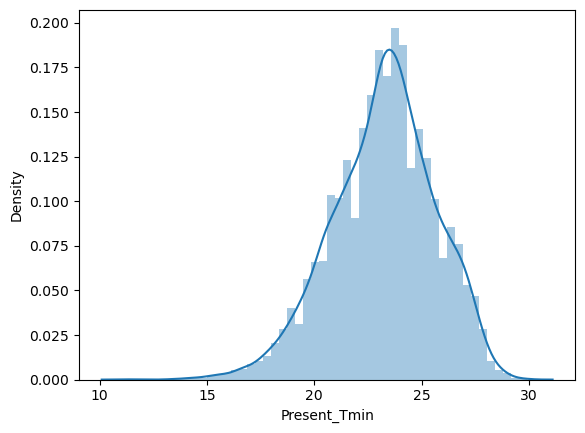

In [62]:
sns.distplot(df['Present_Tmin'])
plt.show()

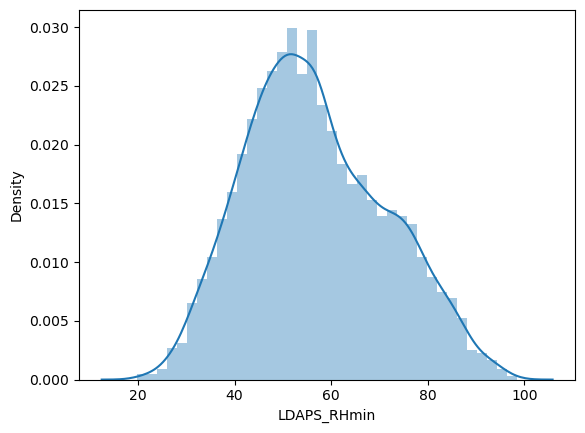

In [63]:
sns.distplot(df['LDAPS_RHmin'])
plt.show()

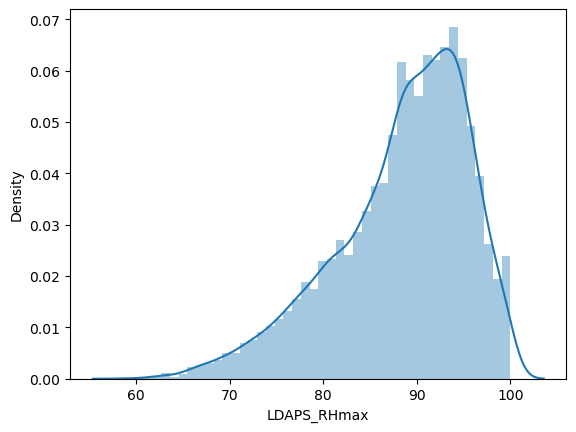

In [64]:
sns.distplot(df['LDAPS_RHmax'])
plt.show()

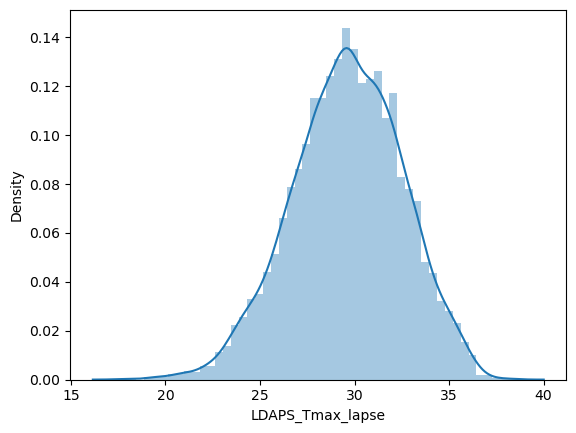

In [65]:
sns.distplot(df['LDAPS_Tmax_lapse'])
plt.show()

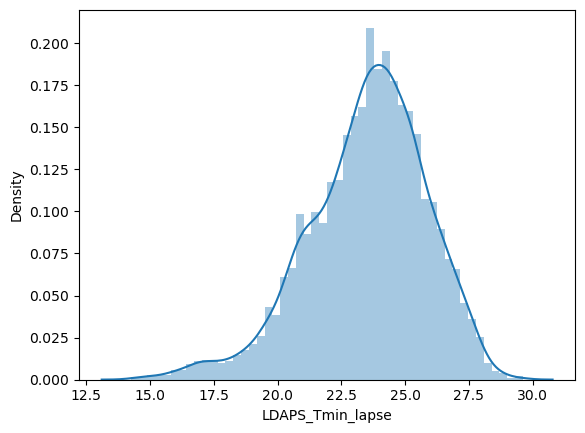

In [66]:
sns.distplot(df['LDAPS_Tmin_lapse'])
plt.show()

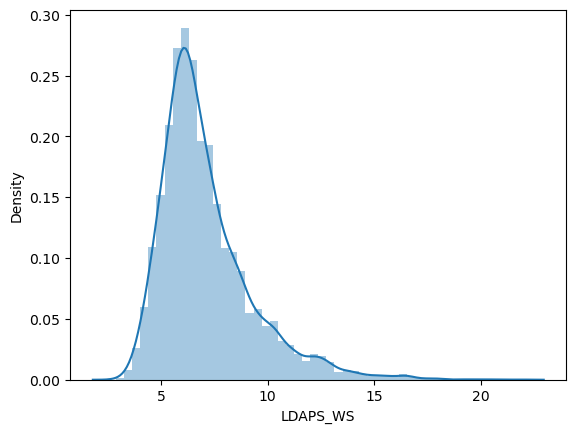

In [67]:
sns.distplot(df['LDAPS_WS'])
plt.show()

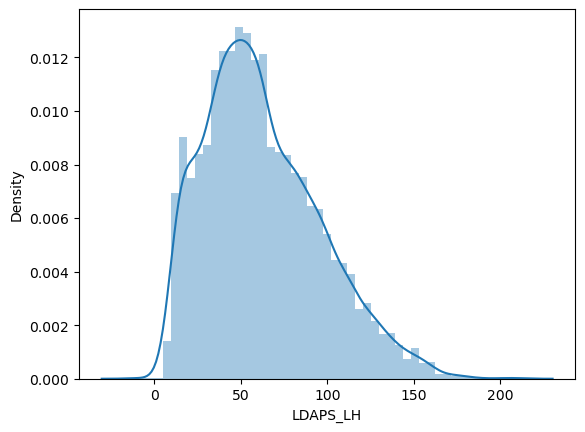

In [68]:
sns.distplot(df['LDAPS_LH'])
plt.show()

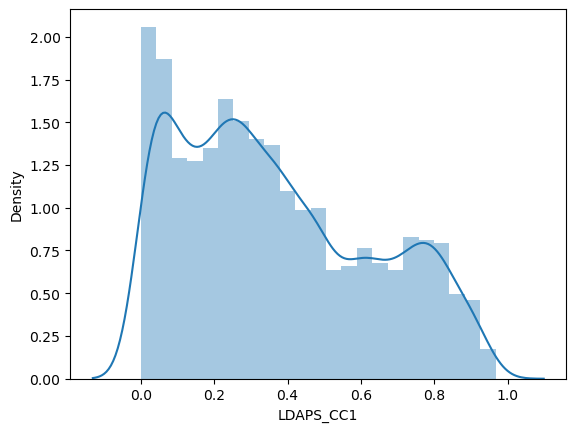

In [152]:
sns.distplot(df['LDAPS_CC1'])
plt.show()

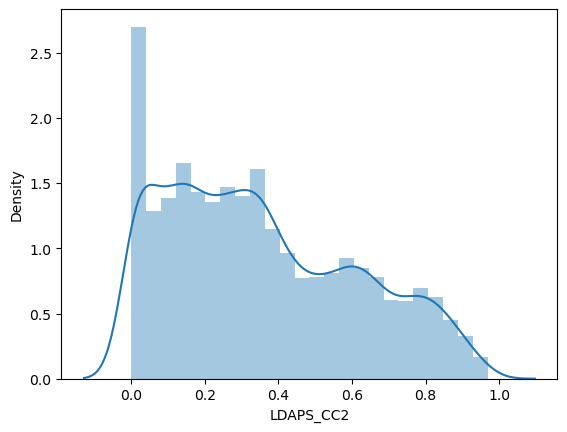

In [153]:
sns.distplot(df['LDAPS_CC2'])
plt.show()

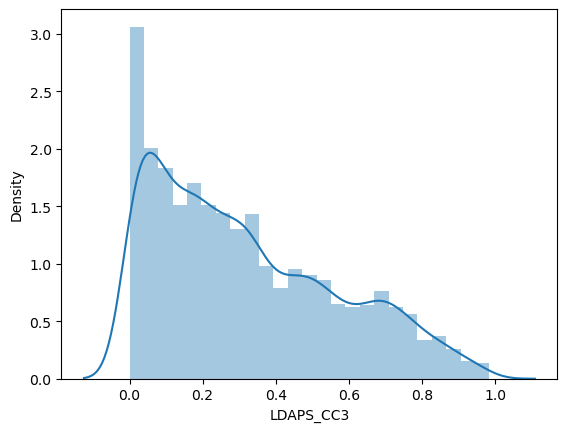

In [154]:
sns.distplot(df['LDAPS_CC3'])
plt.show()

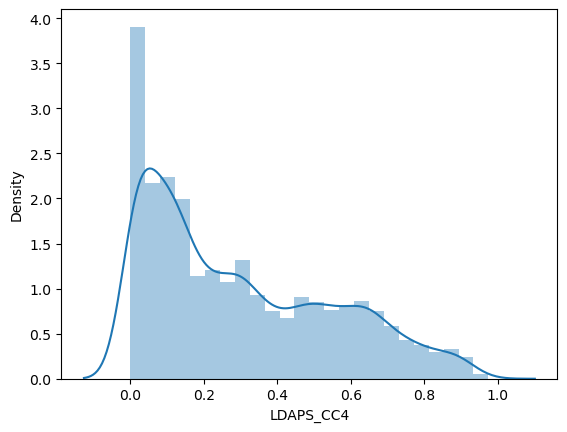

In [155]:
sns.distplot(df['LDAPS_CC4'])
plt.show()

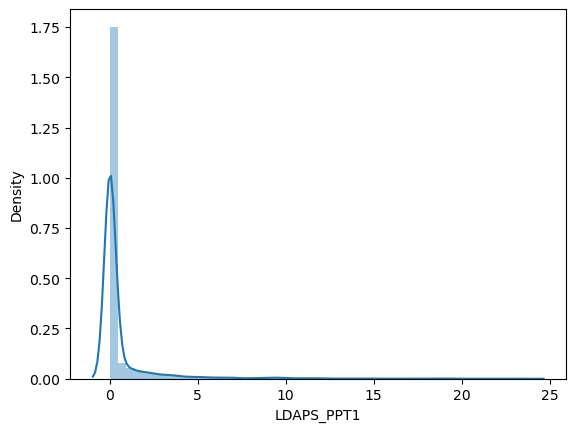

In [156]:
sns.distplot(df['LDAPS_PPT1'])
plt.show()

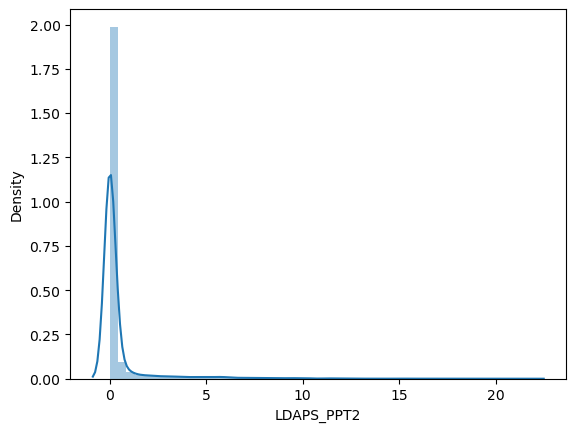

In [157]:
sns.distplot(df['LDAPS_PPT2'])
plt.show()

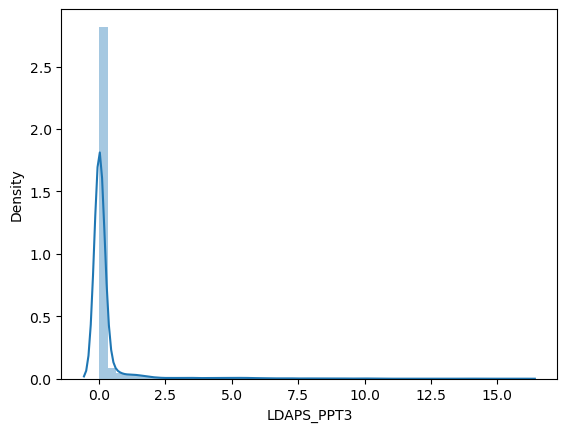

In [158]:
sns.distplot(df['LDAPS_PPT3'])
plt.show()

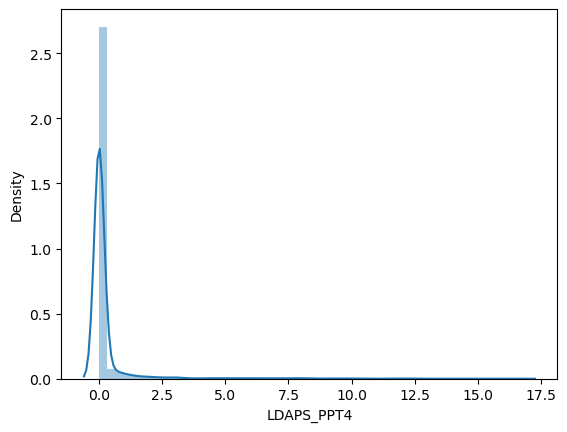

In [159]:
sns.distplot(df['LDAPS_PPT4'])
plt.show()

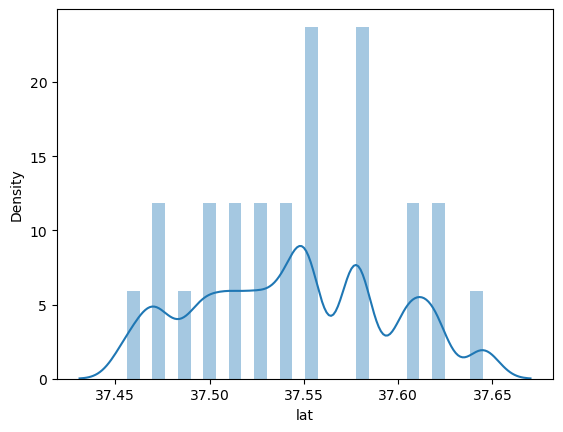

In [160]:
sns.distplot(df['lat'])
plt.show()

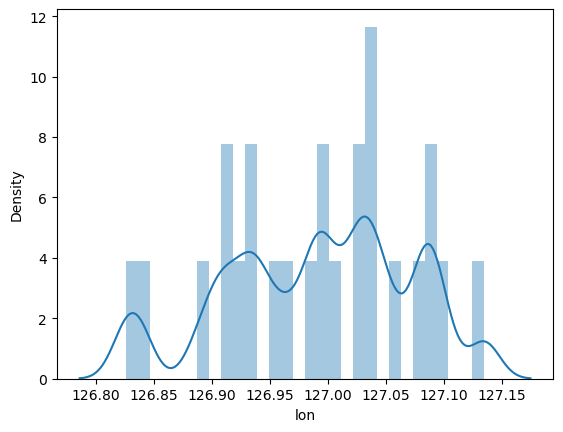

In [161]:
sns.distplot(df['lon'])
plt.show()

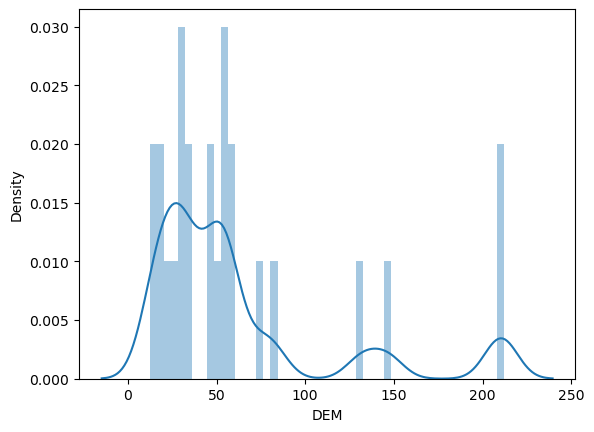

In [162]:
sns.distplot(df['DEM'])
plt.show()

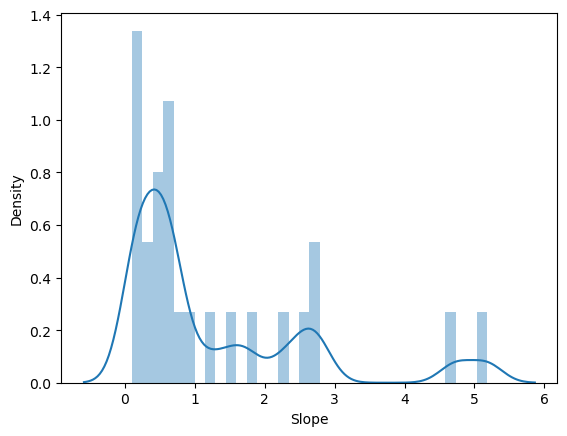

In [163]:
sns.distplot(df['Slope'])
plt.show()

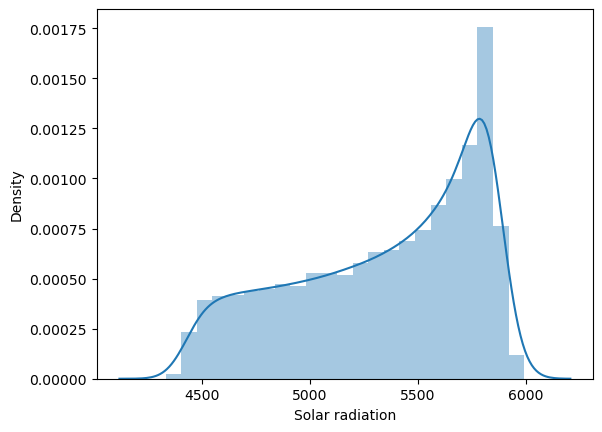

In [164]:
sns.distplot(df['Solar radiation'])
plt.show()

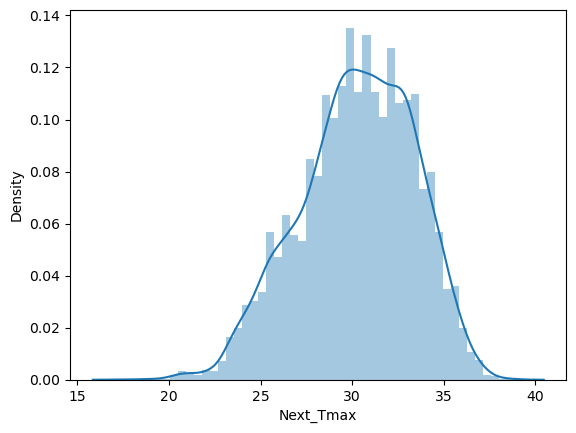

In [165]:
sns.distplot(df['Next_Tmax'])
plt.show()

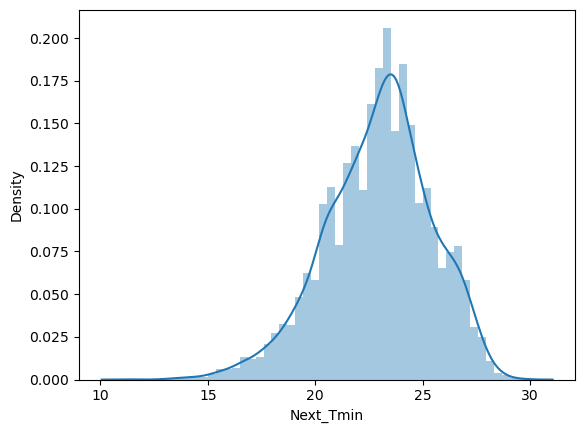

In [166]:
sns.distplot(df['Next_Tmin'])
plt.show()

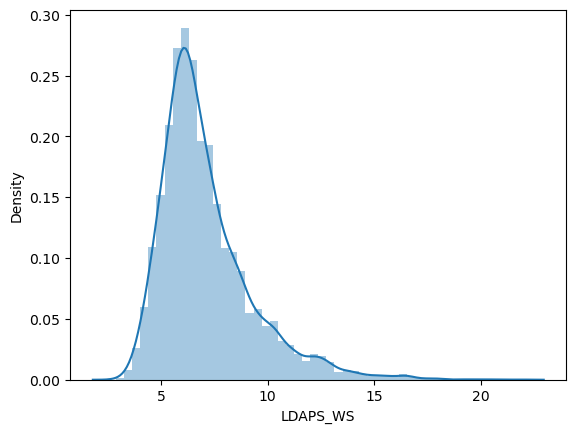

In [167]:
sns.distplot(df['LDAPS_WS'])
plt.show()

## Encoding Categorical Columns

In [61]:
from sklearn.preprocessing import LabelEncoder
df.select_dtypes(include=['object']).columns
label_encoders = {}
for col in df:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

In [62]:
df.dtypes

station             int64
Date                int32
Present_Tmax        int64
Present_Tmin        int64
LDAPS_RHmin         int64
LDAPS_RHmax         int64
LDAPS_Tmax_lapse    int64
LDAPS_Tmin_lapse    int64
LDAPS_WS            int64
LDAPS_LH            int64
LDAPS_CC1           int64
LDAPS_CC2           int64
LDAPS_CC3           int64
LDAPS_CC4           int64
LDAPS_PPT1          int64
LDAPS_PPT2          int64
LDAPS_PPT3          int64
LDAPS_PPT4          int64
lat                 int64
lon                 int64
DEM                 int64
Slope               int64
Solar radiation     int64
Next_Tmax           int64
Next_Tmin           int64
dtype: object

<AxesSubplot:xlabel='Date', ylabel='Density'>

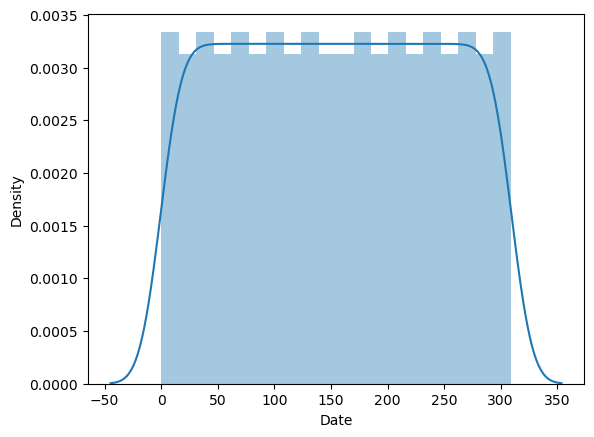

In [63]:
sns.distplot(df['Date'])

## Encoding Categorical Columns¶

In [133]:
from sklearn.preprocessing import LabelEncoder
df.select_dtypes(include=['object']).columns
label_encoders = {}
for col in df_new:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

In [134]:
df.dtypes

station               int64
Date                  int32
Present_Tmax          int64
Present_Tmin          int64
LDAPS_RHmin           int64
LDAPS_RHmax           int64
LDAPS_Tmax_lapse      int64
LDAPS_Tmin_lapse      int64
LDAPS_WS              int64
LDAPS_LH              int64
LDAPS_CC1             int64
LDAPS_CC2             int64
LDAPS_CC3             int64
LDAPS_CC4             int64
LDAPS_PPT1            int64
LDAPS_PPT2            int64
LDAPS_PPT3            int64
LDAPS_PPT4            int64
lat                   int64
lon                   int64
DEM                   int64
Slope                 int64
Solar radiation       int64
Next_Tmax           float64
Next_Tmin             int64
dtype: object

## Separating Lables and Features

Before removing outliers and skewness from the data we will 1st separate the target and feature columns.

In [135]:
x=df.drop('Next_Tmax',axis=1)
y=df['Next_Tmax']

In [136]:
x

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmin
0,0,290,80,73,4446,4441,2281,2868,4328,4819,...,0,0,0,0,9,11,24,22,1574,75
1,1,290,113,75,3258,4182,3985,4229,1943,3348,...,0,0,0,0,9,16,11,9,1531,88
2,2,290,110,93,2472,1848,4244,5014,2957,733,...,0,0,0,0,8,19,9,5,1517,103
3,3,290,114,94,4442,6944,3840,3267,1869,4569,...,0,0,0,0,11,14,12,20,1500,107
4,4,290,108,78,4047,3994,3253,3465,2037,6846,...,0,0,0,0,7,24,10,8,1510,88
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,20,304,24,37,19,816,2038,213,3967,56,...,0,0,0,0,7,17,5,10,38,40
7746,21,304,18,33,118,1791,1241,166,2113,5625,...,0,0,0,0,4,22,4,1,29,34
7747,22,304,26,30,44,899,1042,268,2982,4991,...,0,0,0,0,6,2,1,3,30,44
7748,23,304,26,36,14,681,1442,263,3828,2866,...,0,0,0,0,5,3,2,4,26,51


In [137]:
y

0       29.1
1       30.5
2       31.1
3       31.7
4       31.2
        ... 
7745    27.6
7746    28.0
7747    28.3
7748    28.6
7749    27.8
Name: Next_Tmax, Length: 7750, dtype: float64

In [138]:
x.shape

(7750, 24)

In [139]:
y.shape

(7750,)

In [140]:
x.dtypes

station             int64
Date                int32
Present_Tmax        int64
Present_Tmin        int64
LDAPS_RHmin         int64
LDAPS_RHmax         int64
LDAPS_Tmax_lapse    int64
LDAPS_Tmin_lapse    int64
LDAPS_WS            int64
LDAPS_LH            int64
LDAPS_CC1           int64
LDAPS_CC2           int64
LDAPS_CC3           int64
LDAPS_CC4           int64
LDAPS_PPT1          int64
LDAPS_PPT2          int64
LDAPS_PPT3          int64
LDAPS_PPT4          int64
lat                 int64
lon                 int64
DEM                 int64
Slope               int64
Solar radiation     int64
Next_Tmin           int64
dtype: object

In [141]:
x.shape

(7750, 24)

In [142]:
y.shape

(7750,)

In [143]:
y.value_counts()

29.3    113
33.0    106
31.3    104
29.6    101
31.2     98
       ... 
37.5      1
38.7      1
37.4      1
20.9      1
21.8      1
Name: Next_Tmax, Length: 184, dtype: int64

## Removing Outliers


### Removing Outliers using IQR method

In [144]:
x.shape

(7750, 24)

In [145]:
#removing the outliers by Robust Statistical Measures (IQR method)
Q1 = x.select_dtypes(include=[np.number]).quantile(0.25)
Q3 = x.select_dtypes(include=[np.number]).quantile(0.75)
IQR = Q3 - Q1
outliers_mask = (x.select_dtypes(include=[np.number]) < (Q1 - 1.5 * IQR)) | (x.select_dtypes(include=[np.number]) > (Q3 + 1.5 * IQR))

In [146]:
df_new=x[~outliers_mask.any(axis=1)]

In [147]:
df_new.shape

(4947, 24)

In [ ]:
Initially the shape of our dataset was (7750,24) and now after removal of outliers it has  rows , That means 4487 rows are removed as outliers. 

x.skew()

In [148]:
df_new.skew()

station             0.003864
Date                0.058160
Present_Tmax       -0.285209
Present_Tmin       -0.147466
LDAPS_RHmin         0.210250
LDAPS_RHmax         0.244175
LDAPS_Tmax_lapse   -0.263432
LDAPS_Tmin_lapse    0.004931
LDAPS_WS            0.115433
LDAPS_LH           -0.031323
LDAPS_CC1           0.284504
LDAPS_CC2           0.186968
LDAPS_CC3           0.241292
LDAPS_CC4           0.337300
LDAPS_PPT1          2.148420
LDAPS_PPT2          2.677731
LDAPS_PPT3          3.613596
LDAPS_PPT4          8.188189
lat                -0.332349
lon                 0.038657
DEM                 0.016638
Slope               0.019269
Solar radiation     0.044404
Next_Tmin          -0.217162
dtype: float64

we can see that the skewness in the original datas set is due to the presence of outliers and after removal of outliers we can see that the skew ness has segnificantly decreases. so we will balance it.

In [149]:
skewed_features = ['LDAPS_CC4','LDAPS_PPT1', 'LDAPS_PPT2','LDAPS_PPT3', 'LDAPS_PPT4','Slope']

In [150]:
from scipy.stats import skew,boxcox
from scipy import stats
for feature in skewed_features:
    skewness = skew(df_new[feature])
    print(f"Skewness of {feature}: {skewness}")

Skewness of LDAPS_CC4: 0.3371978537640342
Skewness of LDAPS_PPT1: 2.1477688927976106
Skewness of LDAPS_PPT2: 2.6769190837582957
Skewness of LDAPS_PPT3: 3.612500194336585
Skewness of LDAPS_PPT4: 8.185705536603182
Skewness of Slope: 0.019263421380716298


In [151]:
df_new['LDAPS_CC4'] = np.sqrt(df_new['LDAPS_CC4'])

In [152]:
df_new['LDAPS_PPT1'] = np.cbrt(df_new['LDAPS_PPT1'])

In [153]:
df_new['LDAPS_PPT2'] = np.sqrt(df_new['LDAPS_PPT2'])

In [154]:
df_new['LDAPS_PPT3'] = np.sqrt(df_new['LDAPS_PPT3'])

In [155]:
df_new['LDAPS_PPT4'] = np.sqrt(df_new['LDAPS_PPT4'])

In [156]:
df_new['Slope'] = np.sqrt(df_new['Slope'])

In [157]:
df_new.skew()

station             0.003864
Date                0.058160
Present_Tmax       -0.285209
Present_Tmin       -0.147466
LDAPS_RHmin         0.210250
LDAPS_RHmax         0.244175
LDAPS_Tmax_lapse   -0.263432
LDAPS_Tmin_lapse    0.004931
LDAPS_WS            0.115433
LDAPS_LH           -0.031323
LDAPS_CC1           0.284504
LDAPS_CC2           0.186968
LDAPS_CC3           0.241292
LDAPS_CC4          -0.409877
LDAPS_PPT1          1.355292
LDAPS_PPT2          2.051681
LDAPS_PPT3          2.954621
LDAPS_PPT4          7.197457
lat                -0.332349
lon                 0.038657
DEM                 0.016638
Slope              -0.725870
Solar radiation     0.044404
Next_Tmin          -0.217162
dtype: float64

We only removed skewness from the skewed columns

<Figure size 1200x600 with 0 Axes>

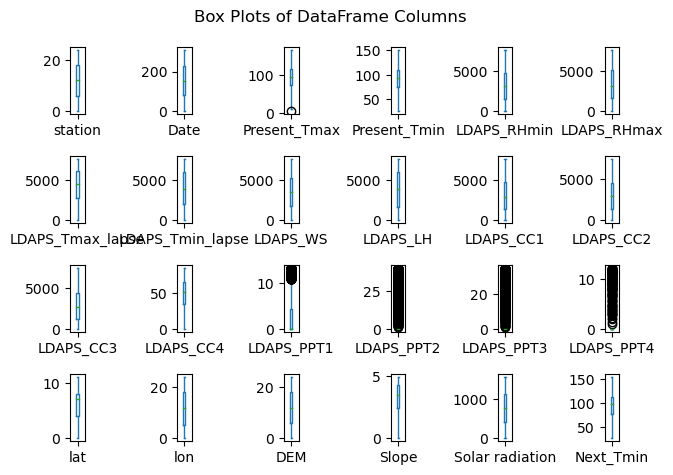

In [158]:
plt.figure(figsize=(12, 6))
df_new.plot(kind='box',subplots=True,layout=(4,6))
plt.suptitle("Box Plots of DataFrame Columns")
plt.tight_layout()
plt.show()

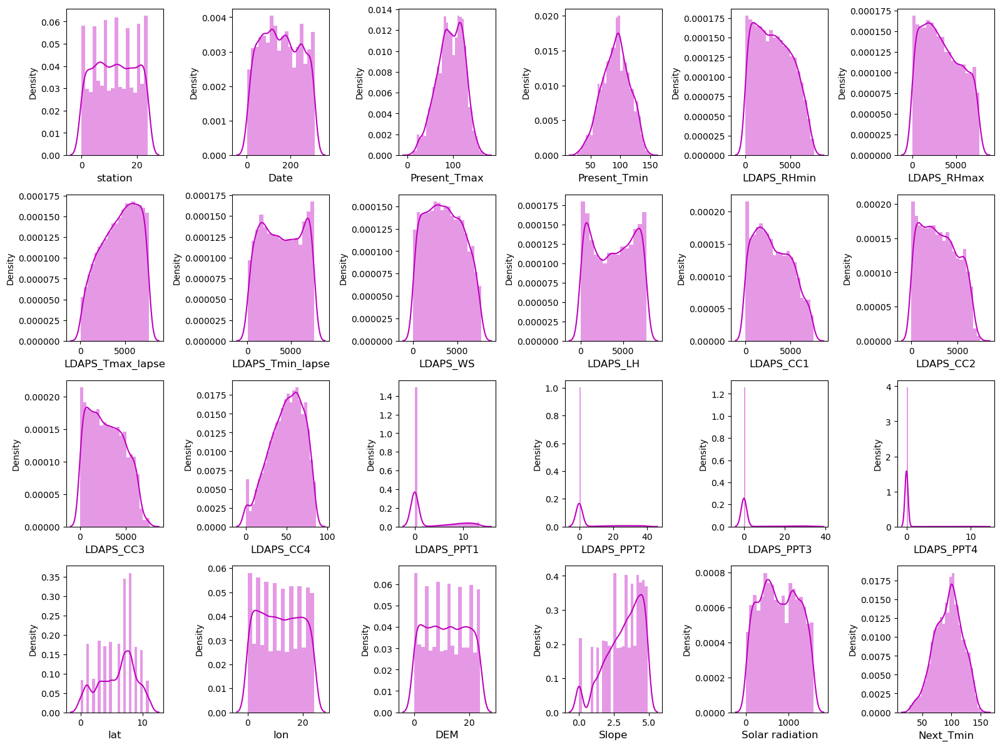

In [159]:
plt.figure(figsize=(16,12))
plotnumber=1
for i in df_new.columns:
    if plotnumber<=24:
        ax=plt.subplot(4,6,plotnumber)
        sns.distplot(df_new[i],color='m')
        plt.xlabel(i,fontsize=12)
        plt.yticks(rotation=0,fontsize=10)
    plotnumber+=1
plt.tight_layout()
plt.show()

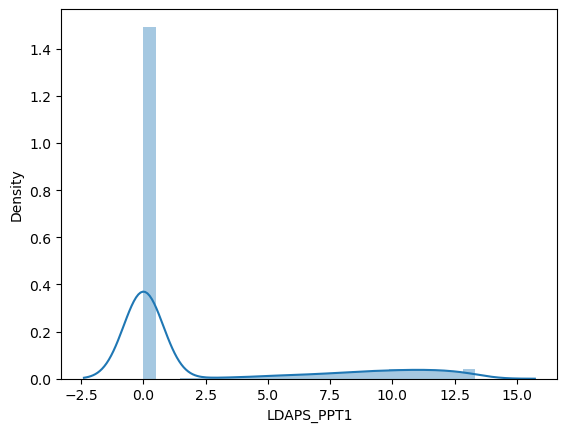

In [160]:
sns.distplot(df_new['LDAPS_PPT1'])
plt.show()

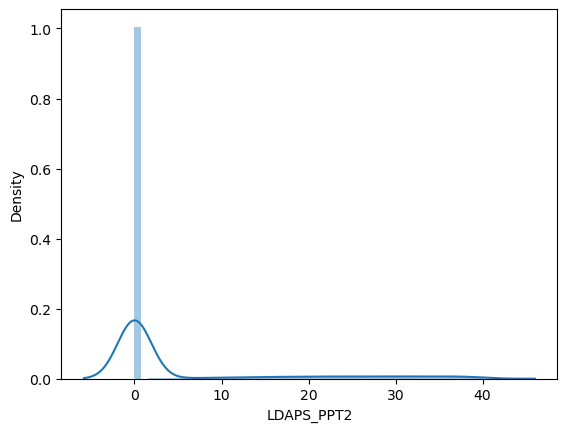

In [161]:
sns.distplot(df_new['LDAPS_PPT2'])
plt.show()

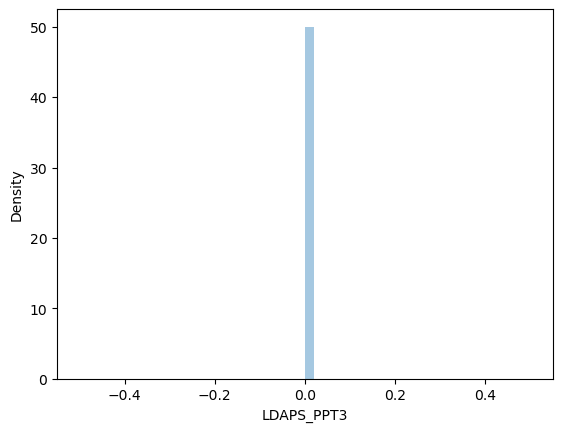

In [199]:
sns.distplot(df_new['LDAPS_PPT3'])
plt.show()

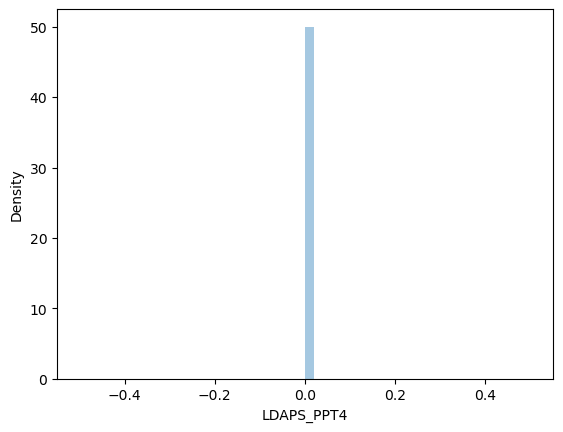

In [200]:
sns.distplot(df_new['LDAPS_PPT4'])
plt.show()

In [162]:
df_new.shape

(4947, 24)

In [163]:
y.shape

(7750,)

Since we have removed the outliers from Feature data and not from target data we can observe a class imbalance here  so we will maintain it by removing the same no of rows from target data too.

In [164]:
y=y[:len(df_new)]

In [165]:
y.shape

(4947,)

Now we have balanced the target and feature. we will move forward with Train test and split

### Spliting the data for training and testing

In [166]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(df_new, y, test_size=0.30, random_state=43)

In [167]:
x_train.shape

(3462, 24)

In [168]:
x_test.shape

(1485, 24)

In [169]:
y_train.shape

(3462,)

In [170]:
y_test.shape

(1485,)

## Model Building

### Finding the best random state

In [14]:
from sklearn.model_selection import train_test_split, GridSearchCV,cross_val_score
from sklearn.linear_model import LinearRegression, SGDRegressor,Ridge, Lasso
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,accuracy_score
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

In [177]:
x_train,x_test,y_train,y_test=train_test_split(df_new,y,test_size=0.3,random_state=45)

In [178]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

maxAccu=0
ln=LinearRegression()
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(df_new,y,test_size=0.3,random_state=i)
    mod=ln
    mod.fit(x_train,y_train)
    pred=mod.predict(x_test)
    acc=r2_score(y_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print('the best accuracy is ',maxAccu,'on random state',maxRS)

the best accuracy is  0.08467931433195175 on random state 3


## Building The Model

In [15]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor

In [16]:
lr=LinearRegression()
RFR=RandomForestRegressor()
knn=KNeighborsRegressor()
gbr=GradientBoostingRegressor()
sv=SVR()
dtc=DecisionTreeRegressor()

In [181]:
print(lr)
print('\n')
x_train,x_test,y_train,y_test=train_test_split(df_new,y,test_size=0.20,random_state=3)
lr.fit(x_train,y_train)
pred=lr.predict(x_test)
print('Mean Squared Error:', mean_squared_error(y_test,pred))
r2 = r2_score(y_test,pred)
print('R-squared score:',r2)
print('\n')

LinearRegression()


Mean Squared Error: 7.174672721818923
R-squared score: 0.09981681212575744




In [182]:
print(RFR)
print('\n')
x_train,x_test,y_train,y_test=train_test_split(df_new,y,test_size=0.20,random_state=3)
RFR.fit(x_train,y_train)
pred=RFR.predict(x_test)
print('Mean Squared Error:', mean_squared_error(y_test,pred))
r2 = r2_score(y_test,pred)
print('R-squared score:',r2)
print('\n')

RandomForestRegressor()


Mean Squared Error: 2.71100838552078
R-squared score: 0.6598584680510405




In [114]:
print(gbr)
print('\n')
x_train,x_test,y_train,y_test=train_test_split(df_new,y,test_size=0.20,random_state=3)
gbr.fit(x_train,y_train)
pred=gbr.predict(x_test)
print('Mean Squared Error:', mean_squared_error(y_test,pred))
r2 = r2_score(y_test,pred)
print('R-squared score:',r2)
print('\n')

GradientBoostingRegressor()


Mean Squared Error: 449.55314603663203
R-squared score: 0.4521231608324118




In [183]:
print(sv)
print('\n')
scaler = StandardScaler()
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

# Create the model
svr = SVR()

# Fit the model to the scaled training data
svr.fit(x_train_scaled, y_train)

# Make predictions on the scaled test data
pred = svr.predict(x_test_scaled)

print('Mean Squared Error:', mean_squared_error(y_test,pred))
r2 = r2_score(y_test,pred)
print('R-squared score:',r2)
print('\n')

SVR()


Mean Squared Error: 5.219962622240522
R-squared score: 0.34506802246422297




In [184]:
print(dtc)
print('\n')
x_train,x_test,y_train,y_test=train_test_split(df_new,y,test_size=0.20,random_state=3)
dtc.fit(x_train,y_train)
pred=dtc.predict(x_test)
print('Mean Squared Error:', mean_squared_error(y_test,pred))
r2 = r2_score(y_test,pred)
print('R-squared score:',r2)
print('\n')

DecisionTreeRegressor()


Mean Squared Error: 5.429099491732397
R-squared score: 0.3188282898407804




The MSE represents the average squared difference between the predicted and actual values, and a lower value indicates better performance. The R-squared score measures the proportion of variance in the target variable that can be explained by the model, and a higher value indicates a better fit to the data.

Based on the results, it seems that the Random Forest Regressor performs the best among the models, with the lowest MSE and highest R-squared score. 

## CROSS VALIDATION SCORE

In [185]:
lr_scores = -cross_val_score(lr, df_new, y, cv=5, scoring='neg_mean_squared_error')
rf_scores = -cross_val_score(RFR, df_new, y, cv=5, scoring='neg_mean_squared_error')
gb_scores = -cross_val_score(gbr, df_new, y, cv=5, scoring='neg_mean_squared_error')
svr_scores = -cross_val_score(sv, df_new, y, cv=5, scoring='neg_mean_squared_error')
dt_scores = -cross_val_score(dtc, df_new, y, cv=5, scoring='neg_mean_squared_error')

# Take the absolute values of the scores
lr_scores = abs(lr_scores)
rf_scores = abs(rf_scores)
gb_scores = abs(gb_scores)
svr_scores = abs(svr_scores)
dt_scores = abs(dt_scores)

# Print the scores
print("Linear Regression() score is:", lr_scores.mean())
print("Random Forest Regressor() score is:", rf_scores.mean())
print("Gradient Boosting Regressor() score is:", gb_scores.mean())
print("SVR() score is:", svr_scores.mean())
print("Decision Tree Regressor() score is:", dt_scores.mean())

Linear Regression() score is: 9.47119941756916
Random Forest Regressor() score is: 10.027771528921804
Gradient Boosting Regressor() score is: 9.538813321138306
SVR() score is: 9.518064641629007
Decision Tree Regressor() score is: 14.898963119663787


Among these models, Linear Regression() has the lowest MSE, indicating the best performance. The Decision Tree Regressor() has the highest MSE, indicating relatively poorer performance compared to the other models.

## Hyper parameter tuning

Linear regression dont have any significant parameters for hyper parameter tuning

In [187]:
from sklearn.preprocessing import StandardScaler
scale=StandardScaler()
xs=scale.fit_transform(df_new)

In [188]:
x_train,x_test,y_train,y_test=train_test_split(xs,y,test_size=0.3,random_state=11)

In [189]:
ln=LinearRegression()
ln.fit(x_train,y_train)
predln=ln.predict(x_test)
print('r2 score is :',round((r2_score(y_test,predln)),3))
print('RMSE:',round(np.sqrt(mean_squared_error(y_test,predln)),3))
print('mean absolute error:',round((mean_absolute_error(y_test,predln)),3))

r2 score is : 0.057
RMSE: 2.756
mean absolute error: 2.264


## Saving the model

In [190]:
import joblib
joblib.dump(ln,'tmax.obj')

['tmax.obj']

# Building the model for Next_Tmin

In [17]:
df2=pd.read_csv('temp.csv')
df2

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [18]:
df2.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [19]:
df2 = df2.fillna(df2.mean())

In [20]:
df2.isnull().sum()

station             0
Date                2
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

In [21]:
df2=df2.dropna()

In [22]:
df2.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

## Encoding Categorical Columns

In [23]:
from sklearn.preprocessing import LabelEncoder
df2.select_dtypes(include=['object']).columns
label_encoders = {}
for col in df2:
    le = LabelEncoder()
    df2[col] = le.fit_transform(df2[col])
    label_encoders[col] = le

In [24]:
df2.dtypes

station             int64
Date                int32
Present_Tmax        int64
Present_Tmin        int64
LDAPS_RHmin         int64
LDAPS_RHmax         int64
LDAPS_Tmax_lapse    int64
LDAPS_Tmin_lapse    int64
LDAPS_WS            int64
LDAPS_LH            int64
LDAPS_CC1           int64
LDAPS_CC2           int64
LDAPS_CC3           int64
LDAPS_CC4           int64
LDAPS_PPT1          int64
LDAPS_PPT2          int64
LDAPS_PPT3          int64
LDAPS_PPT4          int64
lat                 int64
lon                 int64
DEM                 int64
Slope               int64
Solar radiation     int64
Next_Tmax           int64
Next_Tmin           int64
dtype: object

In [25]:
df2.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,0,290,80,73,4446,4441,2281,2868,4328,4819,...,0,0,0,9,11,24,22,1574,92,75
1,1,290,113,75,3258,4182,3985,4229,1943,3348,...,0,0,0,9,16,11,9,1531,107,88
2,2,290,110,93,2472,1848,4244,5014,2957,733,...,0,0,0,8,19,9,5,1517,113,103
3,3,290,114,94,4442,6944,3840,3267,1869,4569,...,0,0,0,11,14,12,20,1500,119,107
4,4,290,108,78,4047,3994,3253,3465,2037,6846,...,0,0,0,7,24,10,8,1510,114,88


In [26]:
x=df2.drop('Next_Tmin',axis=1)
y=df2['Next_Tmin']

In [27]:
x.shape

(7750, 24)

In [28]:
y.shape

(7750,)

## Removing Outliers using IQR Method

In [29]:
#removing the outliers by Robust Statistical Measures (IQR method)
Q1 = x.select_dtypes(include=[np.number]).quantile(0.25)
Q3 = x.select_dtypes(include=[np.number]).quantile(0.75)
IQR = Q3 - Q1
outliers_mask = (x.select_dtypes(include=[np.number]) < (Q1 - 1.5 * IQR)) | (x.select_dtypes(include=[np.number]) > (Q3 + 1.5 * IQR))

In [30]:
df2_new=x[~outliers_mask.any(axis=1)]

In [48]:
df2_new.shape

(4980, 24)

In [32]:
y.shape

(7750,)

In [45]:
y=y[:len(df2_new)]

In [46]:
y.shape

(4980,)

In [47]:
df2_new.skew()

station             0.001855
Date                0.049175
Present_Tmax       -0.292105
Present_Tmin       -0.172575
LDAPS_RHmin         0.216722
LDAPS_RHmax         0.248265
LDAPS_Tmax_lapse   -0.260150
LDAPS_Tmin_lapse    0.005764
LDAPS_WS            0.112960
LDAPS_LH           -0.036702
LDAPS_CC1           0.280996
LDAPS_CC2           0.189510
LDAPS_CC3           0.242876
LDAPS_CC4           0.339591
LDAPS_PPT1          2.159439
LDAPS_PPT2          2.690598
LDAPS_PPT3          3.631362
LDAPS_PPT4          8.190886
lat                -0.335245
lon                 0.038793
DEM                 0.011745
Slope               0.015169
Solar radiation     0.047472
Next_Tmax          -0.354697
dtype: float64

## Model Building

In [36]:
x_train,x_test,y_train,y_test=train_test_split(df2_new,y,test_size=0.3,random_state=11)

In [37]:
ln=LinearRegression()
ln.fit(x_train,y_train)
predln=ln.predict(x_test)
print('r2 score is :',round((r2_score(y_test,predln)),3))
print('RMSE:',round(np.sqrt(mean_squared_error(y_test,predln)),3))
print('mean absolute error:',round((mean_absolute_error(y_test,predln)),3))

r2 score is : 0.072
RMSE: 20.889
mean absolute error: 16.929


In [38]:
ls=Lasso(alpha=0.00001)
ls.fit(x_train,y_train)
predls=ls.predict(x_test)
print('r2 score is :',round((r2_score(y_test,predls)),3))
print('RMSE:',round(np.sqrt(mean_squared_error(y_test,predls)),3))
print('mean absolute error:',round((mean_absolute_error(y_test,predls)),3))

r2 score is : 0.072
RMSE: 20.889
mean absolute error: 16.929


In [39]:
#Ridge model
rd=Ridge(alpha=0.01)
rd.fit(x_train,y_train)
predrd=rd.predict(x_test)
print('r2 score is :',round((r2_score(y_test,predrd)),3))
print('RMSE:',round(np.sqrt(mean_squared_error(y_test,predrd)),3))
print('mean absolute error:',round((mean_absolute_error(y_test,predrd)),3))

r2 score is : 0.072
RMSE: 20.889
mean absolute error: 16.929


In [40]:
rf = RandomForestRegressor(n_estimators=1000)
rf.fit(x_train, y_train)
predrf=rf.predict(x_test)
print('r2 score is :',round((r2_score(y_test,predrf)),3))
print('RMSE:',round(np.sqrt(mean_squared_error(y_test,predrf)),3))
print('mean absolute error:',round((mean_absolute_error(y_test,predrf)),3))

r2 score is : 0.598
RMSE: 13.75
mean absolute error: 10.635


In [43]:
sv.fit(x_train, y_train)
predsvr=sv.predict(x_test)
print('r2 score is :',round((r2_score(y_test,predsvr)),3))
print('RMSE:',round(np.sqrt(mean_squared_error(y_test,predsvr)),3))
print('mean absolute error:',round((mean_absolute_error(y_test,predsvr)),3))

r2 score is : 0.051
RMSE: 21.125
mean absolute error: 16.896


## Cross validation scores

In [49]:
models=[ln,ls,rd,rf,sv]
for m in models:
    
    score=cross_val_score(m,df2_new,y,cv=5)
    print(m,'score is:')
    print(round((score.mean()),3))
    print('\n')

LinearRegression() score is:
-0.341


Lasso(alpha=1e-05) score is:
-0.341


Ridge(alpha=0.01) score is:
-0.341


RandomForestRegressor(n_estimators=1000) score is:
-0.507


SVR() score is:
-0.313




## Hyper parameter tuning

Linear regression dont have any significant parameters for hyper parameter tuning

In [51]:
ln=LinearRegression()
ln.fit(x_train,y_train)
predln=ln.predict(x_test)
print('r2 score is :',round((r2_score(y_test,predln)),3))
print('RMSE:',round(np.sqrt(mean_squared_error(y_test,predln)),3))
print('mean absolute error:',round((mean_absolute_error(y_test,predln)),3))

r2 score is : 0.072
RMSE: 20.889
mean absolute error: 16.929


## Saving the model

In [52]:
import joblib
joblib.dump(ln,'lnnexttmin.obj')

['lnnexttmin.obj']